In [1]:
import os
import random
import numpy as np
from tqdm import tqdm
import shutil
from IPython.display import HTML

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init

import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

from data_helper_color_map import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box

In [2]:
random.seed(0)
np.random.seed(0)
torch.manual_seed(0);

device = ("cuda:0" if torch.cuda.is_available() else "cpu")

In [3]:
data_dir = '/home/alexander/data'
annotation_csv = '/home/alexander/data/annotation.csv'

resume_training_from_checkpoint = False
load_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to200_checkpoint.pth.tar'
save_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to200_checkpoint.pth.tar'

In [4]:
def save_checkpoint(fpath, state):
    torch.save(state, fpath)
    
def print_sys_mem_usage():
    print("Memory usage (RAM):\n")
    !free -h
    print("\nGPU Memory Usage:\n")
    !nvidia-smi --query-gpu=memory.used --format=csv
    !nvidia-smi --query-gpu=memory.total --format=csv
    print("\n")
    
def print_train_stats(epoch, n_epochs, i, n_batches, loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post):
    print('Epoch: [%d/%d]\tBatch: [%d/%d]\n' % (epoch + 1, n_epochs, i, n_batches),
          'Loss_D: %.4f\tLoss_G: %.4f\n' % (loss_d_total.item(), loss_g_total.item()),
          'D(real): %.4f  ||  D(gen) Pre-step: %.4f  ||  D(gen) Post-step: %.4f\n' %
          (d_real_mean, d_gen_mean_pre, d_gen_mean_post))

### Set Initial Parameters

In [5]:
batch_size = 32

### Create Dataset and Dataloader

In [6]:
unlabeled_scene_index = np.arange(106)
labeled_scene_index_train = np.arange(106, 130)
labeled_scene_index_test = np.arange(130, 134)

In [7]:
labeled_trainset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_train,
                                  img_transform=transforms.Compose([transforms.Resize((256,256)),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

trainloader = torch.utils.data.DataLoader(labeled_trainset,
                                          batch_size=batch_size,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [8]:
labeled_trainset[1][0].size()

torch.Size([18, 256, 256])

In [9]:
for images, road_maps in trainloader:
    print(road_maps.size())
    break

torch.Size([32, 3, 256, 256])


### Define models

In [10]:
class ResnetBlock(nn.Module):
    """
    Define a Resnet block
    A resnet block is a conv block with skip connections
    Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
    """
    def __init__(self, dim):
        """
        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not
        """
        super(ResnetBlock, self).__init__()
        self.resnet_block = nn.Sequential(nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim),
                                          nn.ReLU(True),
                                          nn.Dropout(0.5),
                                          nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim)
                                         )
        
    def forward(self, x):
        return x + self.resnet_block(x)  # add skip connections

In [11]:
class Generator(nn.Module):
    """
    RESNET-based generator that consists of Resnet blocks + downsampling/upsampling operations.
    """
    def __init__(self, in_ch, out_ch, ngf, n_blocks=6, init_gain=0.02):
        """
        Parameters:
            in_ch (int)         -- the number of channels in input images
            out_ch (int)        -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """        
        assert(n_blocks >= 0)
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            
            nn.Conv2d(in_ch, ngf, kernel_size=7, padding=0),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            nn.Conv2d(ngf, ngf * 2, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            nn.Conv2d(ngf * 2, ngf * 4, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            ResnetBlock(ngf * 4),  #1
            ResnetBlock(ngf * 4),  #2
            ResnetBlock(ngf * 4),  #3
            ResnetBlock(ngf * 4),  #4
            ResnetBlock(ngf * 4),  #5
            ResnetBlock(ngf * 4),  #6
            ResnetBlock(ngf * 4),  #7
            ResnetBlock(ngf * 4),  #8
            ResnetBlock(ngf * 4),  #9

            nn.ConvTranspose2d(ngf * 4, int(ngf * 2), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf * 2)),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf * 2, int(ngf), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf)),
            nn.ReLU(True),

            nn.ReflectionPad2d(3),
            nn.Conv2d(ngf, out_ch, kernel_size=7, padding=0),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.model(x)

In [12]:
class Discriminator(nn.Module):
    def __init__(self, in_ch, ndf=64, n_layers=3):  
        super(Discriminator, self).__init__()
        
        self.block1 = nn.Sequential(nn.Conv2d(in_ch, ndf, kernel_size=4, stride=2, padding=1),
                                    nn.LeakyReLU(0.2, True)
                                   )
        
        nf_mult = 1
        nf_mult_prev = 1
        sequence2 = []        
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence2 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=2, padding=1),
                         nn.BatchNorm2d(ndf * nf_mult),
                         nn.LeakyReLU(0.2, True)
                         ]
        self.block2 = nn.Sequential(*sequence2)
        
        sequence3 = []
        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence3 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=1, padding=1),
                     nn.BatchNorm2d(ndf * nf_mult),
                     nn.LeakyReLU(0.2, True)
                     ]
        self.block3 = nn.Sequential(*sequence3)
        
        self.model = nn.Sequential(self.block1,
                                   self.block2,
                                   self.block3,
                                   nn.Conv2d(ndf * nf_mult, 1, kernel_size=4, stride=1, padding=1)
                                  )
        
    def forward(self, x):
        return self.model(x)

In [13]:
# # Sanity check - dimensions of inputs and outputs to both networks.

# test = torch.zeros([batch_size, 18, 256, 256])
# print("Input to generator:\t", test.size())

# test_generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02)
# test_result_g = test_generator(test)
# print("\nOutput of generator:\t", test_result_g.size())

# test_d_input = torch.cat((test_result_g, test), 1)
# print("\nInput to discriminator:\t", test_d_input.size())

# test_discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d)
# test_result_d = test_discriminator(test_d_input)
# print("\nOutput of discriminator:", test_result_d.size())

In [14]:
class GANLoss(nn.Module):
    """
    The GANLoss class abstracts away the need to create the target label tensor
    that has the same size as the input.
    """
    def __init__(self, gan_mode, real_label=1.0, gen_label=0.0):
        """
        Parameters:
            gan_mode (str) - - the type of GAN objective. It currently supports vanilla, lsgan, and wgangp.
            target_real_label (bool) - - label for a real image
            target_gen_label (bool) - - label of a generated image
        Note: Do not use sigmoid as the last layer of Discriminator.
        LSGAN needs no sigmoid. vanilla GANs will handle it with BCEWithLogitsLoss.
        """
        super(GANLoss, self).__init__()
        
        self.gan_mode = gan_mode
        self.real_label = real_label
        self.gen_label = gen_label
        
        if gan_mode == 'LS':
            self.loss = nn.MSELoss().to(device)
        elif gan_mode == 'BCE':
            self.loss = nn.BCEWithLogitsLoss().to(device)

    def get_target_tensor(self, output, target_is_real):
        # Create label tensors with same size as the discriminator output.
        if target_is_real:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.real_label])
            else:
                target_tensor = torch.Tensor([self.real_label])
        else:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.gen_label])
            else:
                target_tensor = torch.Tensor([self.gen_label])
                
        return target_tensor.expand_as(output)

    def __call__(self, output, target_is_real):
        target_tensor = self.get_target_tensor(output, target_is_real)
        loss = self.loss(output, target_tensor)
        return loss

In [15]:
def init_weights(m):  # define the initialization function
    classname = m.__class__.__name__
    if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
        init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
        init.normal_(m.weight.data, 1.0, 0.02)
        init.constant_(m.bias.data, 0.0)

### Train

In [16]:
update_stats_rate = 25
debug_mem_usage = False
losses_g = []
losses_d = []
intermediate_images = []

In [17]:
in_ch = 18
out_ch = 3
ngf = 64
ndf = 64
n_blocks_g = 9
n_layers_d = 3

start_epoch = 0
n_epochs = 200
lr_g = 0.0001
lr_d = 0.0004
beta1 = 0.5
beta2 = 0.999
L1_lambda = 100

real_label = 0.95
gen_label = 0.0

In [18]:
generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02).to(device)
discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d).to(device)

generator.apply(init_weights)
discriminator.apply(init_weights)

generator.train()
discriminator.train()


# We combine GAN Loss and L1 Loss to attain Total Loss
criterion_gan = GANLoss('BCE', real_label=real_label, gen_label=gen_label).to(device)
criterion_L1 = nn.L1Loss().to(device)

optim_G = torch.optim.Adam(generator.parameters(), lr=lr_g, betas=(beta1, beta2))
optim_D = torch.optim.Adam(discriminator.parameters(), lr=lr_d, betas=(beta1, beta2))

In [19]:
"""
Optional: Load checkpoint from most recent training run if resuming from previous trial.
"""
if resume_training_from_checkpoint:
    if os.path.isfile(load_checkpoint_path):
        print("=> loading checkpoint '{}'".format(load_checkpoint_path))
        
        checkpoint = torch.load(load_checkpoint_path)
        start_epoch = checkpoint['epoch']
        losses_g = checkpoint['losses_g']
        losses_d = checkpoint['losses_d']
        intermediate_images = checkpoint['intermediate_images']
        
        generator.load_state_dict(checkpoint['g_state_dict'])
        discriminator.load_state_dict(checkpoint['d_state_dict'])
        optim_G.load_state_dict(checkpoint['optim_g'])
        optim_D.load_state_dict(checkpoint['optim_d'])
        
        print("=> loaded checkpoint '{}' (epoch {})".format(load_checkpoint_path, checkpoint['epoch']))
    else:
        print("=> no checkpoint found at '{}'".format(load_checkpoint_path))

In [20]:
####################################
########## TRAINING LOOP ###########
####################################

n_batches = len(trainloader)
for epoch in range(start_epoch, n_epochs):
    iters = 1
    for real_18ch, real_map in tqdm(trainloader):
        """
        TRAIN DISCRIMINATOR ON BOTH REAL + GENERATED SAMPLES
        """
        real_18ch = real_18ch.to(device)
        real_map = real_map.to(device)
        
        gen_map = generator(real_18ch)
        
        real_19ch = torch.cat((real_18ch, real_map), 1).to(device)
        gen_19ch = torch.cat((real_18ch, gen_map), 1).to(device)

        output_real = discriminator(real_19ch)
        output_gen = discriminator(gen_19ch.detach())
        
        d_real_mean = output_real.mean().item()
        d_gen_mean_pre = output_gen.mean().item()

        # Make label tensors.
        target_real = torch.Tensor([real_label]).expand_as(output_real).to(device)
        target_gen = torch.Tensor([gen_label]).expand_as(output_gen).to(device)

        # Compute loss.
        loss_d_real = criterion_gan(output_real, target_is_real=True)
        loss_d_gen = criterion_gan(output_gen, target_is_real=False)
        loss_d_total = (loss_d_real + loss_d_gen)

        discriminator.zero_grad()
        loss_d_total.backward()
        optim_D.step()
        
        """
        TRAIN GENERATOR
        """
        output_gen = discriminator(gen_19ch)
        loss_g_gan = criterion_gan(output_gen, target_is_real=True)
        loss_g_L1 = L1_lambda * criterion_L1(gen_map, real_map)
        loss_g_total = loss_g_gan + loss_g_L1
        d_gen_mean_post = output_gen.mean().item()
        
        generator.zero_grad()
        loss_g_total.backward()
        optim_G.step()
        
        """
        COMPILE TRAINING STATISTICS
        """
        losses_d.append(loss_d_total.item())
        losses_g.append(loss_g_total.item())
        
        if iters % update_stats_rate == 1:
            print_train_stats(epoch, n_epochs, iters, n_batches,
                              loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post)

        iters += 1
    
    # Add generated image to intermediate images list.
    with torch.no_grad():
        gen_map = generator(real_18ch).detach().cpu()
    intermediate_images.append(vutils.make_grid(gen_map, normalize=True))
    
    save_checkpoint(save_checkpoint_path,
                    {'epoch': epoch + 1,
                     'g_state_dict': generator.state_dict(),
                     'd_state_dict': discriminator.state_dict(),
                     'optim_g' : optim_G.state_dict(),
                     'optim_d' : optim_D.state_dict(),
                     'losses_g' : losses_g,
                     'losses_d' : losses_d,
                     'intermediate_images' : intermediate_images,                     
                    })
    
    if debug_mem_usage and epoch % 10 == 0:
        print_sys_mem_usage()

  1%|          | 1/95 [00:05<08:30,  5.43s/it]

Epoch: [1/200]	Batch: [1/95]
 Loss_D: 1.6735	Loss_G: 74.0255
 D(real): -0.2702  ||  D(gen) Pre-step: -0.2744  ||  D(gen) Post-step: 0.0275



 27%|██▋       | 26/95 [00:52<02:06,  1.84s/it]

Epoch: [1/200]	Batch: [26/95]
 Loss_D: 1.4109	Loss_G: 15.7764
 D(real): -0.1126  ||  D(gen) Pre-step: -0.1199  ||  D(gen) Post-step: -0.0858



 54%|█████▎    | 51/95 [01:42<01:30,  2.06s/it]

Epoch: [1/200]	Batch: [51/95]
 Loss_D: 1.4748	Loss_G: 14.3838
 D(real): -0.0963  ||  D(gen) Pre-step: -0.1077  ||  D(gen) Post-step: -0.1141



 80%|████████  | 76/95 [02:29<00:34,  1.83s/it]

Epoch: [1/200]	Batch: [76/95]
 Loss_D: 1.3960	Loss_G: 12.6033
 D(real): -0.0794  ||  D(gen) Pre-step: -0.1216  ||  D(gen) Post-step: -0.1043



  1%|          | 1/95 [00:04<07:15,  4.64s/it]

Epoch: [2/200]	Batch: [1/95]
 Loss_D: 1.5343	Loss_G: 11.4560
 D(real): -0.1480  ||  D(gen) Pre-step: -0.2591  ||  D(gen) Post-step: -0.0600



 27%|██▋       | 26/95 [00:52<02:05,  1.82s/it]

Epoch: [2/200]	Batch: [26/95]
 Loss_D: 1.4038	Loss_G: 12.0944
 D(real): 0.0698  ||  D(gen) Pre-step: -0.1532  ||  D(gen) Post-step: -0.2430



 54%|█████▎    | 51/95 [01:40<01:28,  2.02s/it]

Epoch: [2/200]	Batch: [51/95]
 Loss_D: 1.2667	Loss_G: 11.0822
 D(real): -0.0057  ||  D(gen) Pre-step: -0.3233  ||  D(gen) Post-step: -0.2906



 80%|████████  | 76/95 [02:28<00:34,  1.82s/it]

Epoch: [2/200]	Batch: [76/95]
 Loss_D: 1.2756	Loss_G: 12.1788
 D(real): 0.0440  ||  D(gen) Pre-step: -0.2543  ||  D(gen) Post-step: -0.2880



  1%|          | 1/95 [00:04<07:09,  4.57s/it]

Epoch: [3/200]	Batch: [1/95]
 Loss_D: 1.2929	Loss_G: 10.8950
 D(real): -0.1165  ||  D(gen) Pre-step: -0.6761  ||  D(gen) Post-step: -0.4357



 27%|██▋       | 26/95 [00:52<02:04,  1.80s/it]

Epoch: [3/200]	Batch: [26/95]
 Loss_D: 1.0288	Loss_G: 12.2483
 D(real): 0.6613  ||  D(gen) Pre-step: -0.5459  ||  D(gen) Post-step: -1.0655



 54%|█████▎    | 51/95 [01:39<01:24,  1.92s/it]

Epoch: [3/200]	Batch: [51/95]
 Loss_D: 0.8880	Loss_G: 12.0218
 D(real): 1.0460  ||  D(gen) Pre-step: -0.8209  ||  D(gen) Post-step: -1.2426



 80%|████████  | 76/95 [02:25<00:33,  1.76s/it]

Epoch: [3/200]	Batch: [76/95]
 Loss_D: 0.8744	Loss_G: 11.4209
 D(real): 0.6144  ||  D(gen) Pre-step: -0.9658  ||  D(gen) Post-step: -0.8115



  1%|          | 1/95 [00:04<07:21,  4.70s/it]

Epoch: [4/200]	Batch: [1/95]
 Loss_D: 0.6440	Loss_G: 13.1199
 D(real): 1.2921  ||  D(gen) Pre-step: -1.9462  ||  D(gen) Post-step: -2.0595



 27%|██▋       | 26/95 [00:52<02:07,  1.85s/it]

Epoch: [4/200]	Batch: [26/95]
 Loss_D: 0.6552	Loss_G: 10.8532
 D(real): 0.8508  ||  D(gen) Pre-step: -1.4703  ||  D(gen) Post-step: -1.2189



 54%|█████▎    | 51/95 [01:40<01:26,  1.96s/it]

Epoch: [4/200]	Batch: [51/95]
 Loss_D: 0.8162	Loss_G: 12.9406
 D(real): 1.4175  ||  D(gen) Pre-step: -0.5467  ||  D(gen) Post-step: -2.4410



 80%|████████  | 76/95 [02:27<00:33,  1.76s/it]

Epoch: [4/200]	Batch: [76/95]
 Loss_D: 0.5430	Loss_G: 12.0667
 D(real): 1.6646  ||  D(gen) Pre-step: -1.9528  ||  D(gen) Post-step: -1.3412



  1%|          | 1/95 [00:04<07:07,  4.55s/it]

Epoch: [5/200]	Batch: [1/95]
 Loss_D: 0.4984	Loss_G: 11.3609
 D(real): 1.1926  ||  D(gen) Pre-step: -2.0172  ||  D(gen) Post-step: -1.9353



 27%|██▋       | 26/95 [00:51<02:05,  1.81s/it]

Epoch: [5/200]	Batch: [26/95]
 Loss_D: 0.6744	Loss_G: 13.6039
 D(real): 0.5888  ||  D(gen) Pre-step: -1.8839  ||  D(gen) Post-step: -1.3146



 54%|█████▎    | 51/95 [01:38<01:25,  1.95s/it]

Epoch: [5/200]	Batch: [51/95]
 Loss_D: 0.4849	Loss_G: 12.2390
 D(real): 1.3078  ||  D(gen) Pre-step: -2.3870  ||  D(gen) Post-step: -2.3407



 80%|████████  | 76/95 [02:26<00:34,  1.80s/it]

Epoch: [5/200]	Batch: [76/95]
 Loss_D: 0.7155	Loss_G: 11.9958
 D(real): 0.8506  ||  D(gen) Pre-step: -1.4584  ||  D(gen) Post-step: -1.3002



  1%|          | 1/95 [00:04<07:18,  4.66s/it]

Epoch: [6/200]	Batch: [1/95]
 Loss_D: 0.7904	Loss_G: 12.6415
 D(real): 0.5426  ||  D(gen) Pre-step: -1.4885  ||  D(gen) Post-step: -1.1908



 27%|██▋       | 26/95 [00:50<01:58,  1.72s/it]

Epoch: [6/200]	Batch: [26/95]
 Loss_D: 0.7191	Loss_G: 12.3756
 D(real): 0.7775  ||  D(gen) Pre-step: -1.7769  ||  D(gen) Post-step: -1.3543



 54%|█████▎    | 51/95 [01:38<01:27,  2.00s/it]

Epoch: [6/200]	Batch: [51/95]
 Loss_D: 0.6439	Loss_G: 12.7219
 D(real): 1.7771  ||  D(gen) Pre-step: -1.5678  ||  D(gen) Post-step: -1.9063



 80%|████████  | 76/95 [02:24<00:34,  1.79s/it]

Epoch: [6/200]	Batch: [76/95]
 Loss_D: 0.9143	Loss_G: 11.0224
 D(real): -0.0872  ||  D(gen) Pre-step: -2.2466  ||  D(gen) Post-step: 0.1576



  1%|          | 1/95 [00:04<07:03,  4.50s/it]

Epoch: [7/200]	Batch: [1/95]
 Loss_D: 0.5489	Loss_G: 13.7301
 D(real): 2.5854  ||  D(gen) Pre-step: -1.1304  ||  D(gen) Post-step: -2.5030



 27%|██▋       | 26/95 [00:51<02:03,  1.79s/it]

Epoch: [7/200]	Batch: [26/95]
 Loss_D: 0.6417	Loss_G: 13.2263
 D(real): 0.7108  ||  D(gen) Pre-step: -1.9424  ||  D(gen) Post-step: -0.9297



 54%|█████▎    | 51/95 [01:40<01:28,  2.02s/it]

Epoch: [7/200]	Batch: [51/95]
 Loss_D: 0.9875	Loss_G: 12.6818
 D(real): 1.3826  ||  D(gen) Pre-step: -1.2292  ||  D(gen) Post-step: -1.8259



 80%|████████  | 76/95 [02:28<00:39,  2.10s/it]

Epoch: [7/200]	Batch: [76/95]
 Loss_D: 0.5205	Loss_G: 11.7679
 D(real): 1.1939  ||  D(gen) Pre-step: -2.0933  ||  D(gen) Post-step: -1.6994



  1%|          | 1/95 [00:04<07:24,  4.73s/it]

Epoch: [8/200]	Batch: [1/95]
 Loss_D: 0.6695	Loss_G: 11.6648
 D(real): 1.1522  ||  D(gen) Pre-step: -1.3188  ||  D(gen) Post-step: -1.5277



 27%|██▋       | 26/95 [00:52<02:03,  1.79s/it]

Epoch: [8/200]	Batch: [26/95]
 Loss_D: 0.7868	Loss_G: 11.8118
 D(real): 0.5549  ||  D(gen) Pre-step: -2.0084  ||  D(gen) Post-step: -0.9854



 54%|█████▎    | 51/95 [01:40<01:28,  2.00s/it]

Epoch: [8/200]	Batch: [51/95]
 Loss_D: 0.7650	Loss_G: 14.0042
 D(real): 2.4318  ||  D(gen) Pre-step: -1.0007  ||  D(gen) Post-step: -2.8767



 80%|████████  | 76/95 [02:26<00:34,  1.83s/it]

Epoch: [8/200]	Batch: [76/95]
 Loss_D: 0.5730	Loss_G: 13.5224
 D(real): 1.1809  ||  D(gen) Pre-step: -2.3737  ||  D(gen) Post-step: -2.0744



  1%|          | 1/95 [00:04<07:18,  4.67s/it]

Epoch: [9/200]	Batch: [1/95]
 Loss_D: 0.7252	Loss_G: 13.7591
 D(real): 2.3245  ||  D(gen) Pre-step: -0.7867  ||  D(gen) Post-step: -2.8756



 27%|██▋       | 26/95 [00:50<02:02,  1.78s/it]

Epoch: [9/200]	Batch: [26/95]
 Loss_D: 0.6401	Loss_G: 12.5678
 D(real): 2.3741  ||  D(gen) Pre-step: -0.8404  ||  D(gen) Post-step: -1.8979



 54%|█████▎    | 51/95 [01:37<01:25,  1.95s/it]

Epoch: [9/200]	Batch: [51/95]
 Loss_D: 0.8314	Loss_G: 11.7962
 D(real): 0.5632  ||  D(gen) Pre-step: -1.3146  ||  D(gen) Post-step: -0.2175



 80%|████████  | 76/95 [02:24<00:35,  1.87s/it]

Epoch: [9/200]	Batch: [76/95]
 Loss_D: 0.5033	Loss_G: 14.0648
 D(real): 1.5018  ||  D(gen) Pre-step: -1.6771  ||  D(gen) Post-step: -2.4620



  1%|          | 1/95 [00:04<07:25,  4.74s/it]

Epoch: [10/200]	Batch: [1/95]
 Loss_D: 1.1745	Loss_G: 12.7850
 D(real): 3.3962  ||  D(gen) Pre-step: -0.5431  ||  D(gen) Post-step: -3.1317



 27%|██▋       | 26/95 [00:50<02:03,  1.79s/it]

Epoch: [10/200]	Batch: [26/95]
 Loss_D: 0.5672	Loss_G: 13.1565
 D(real): 2.2104  ||  D(gen) Pre-step: -1.0582  ||  D(gen) Post-step: -2.5442



 54%|█████▎    | 51/95 [01:38<01:23,  1.91s/it]

Epoch: [10/200]	Batch: [51/95]
 Loss_D: 0.5359	Loss_G: 11.9077
 D(real): 0.8223  ||  D(gen) Pre-step: -2.4773  ||  D(gen) Post-step: -1.8680



 80%|████████  | 76/95 [02:26<00:39,  2.06s/it]

Epoch: [10/200]	Batch: [76/95]
 Loss_D: 0.6381	Loss_G: 12.4516
 D(real): 1.8800  ||  D(gen) Pre-step: -1.2180  ||  D(gen) Post-step: -2.2068



  1%|          | 1/95 [00:04<07:18,  4.67s/it]

Epoch: [11/200]	Batch: [1/95]
 Loss_D: 2.5636	Loss_G: 12.4645
 D(real): 1.4163  ||  D(gen) Pre-step: -1.2700  ||  D(gen) Post-step: -2.1633



 27%|██▋       | 26/95 [00:51<02:06,  1.84s/it]

Epoch: [11/200]	Batch: [26/95]
 Loss_D: 0.6721	Loss_G: 11.7643
 D(real): 1.5297  ||  D(gen) Pre-step: -0.8452  ||  D(gen) Post-step: -2.0562



 54%|█████▎    | 51/95 [01:38<01:23,  1.91s/it]

Epoch: [11/200]	Batch: [51/95]
 Loss_D: 0.8676	Loss_G: 11.3054
 D(real): 1.5680  ||  D(gen) Pre-step: -0.3258  ||  D(gen) Post-step: -2.1991



 80%|████████  | 76/95 [02:25<00:34,  1.80s/it]

Epoch: [11/200]	Batch: [76/95]
 Loss_D: 0.8129	Loss_G: 11.5470
 D(real): 0.5393  ||  D(gen) Pre-step: -1.2018  ||  D(gen) Post-step: -1.4528



  1%|          | 1/95 [00:04<07:07,  4.55s/it]

Epoch: [12/200]	Batch: [1/95]
 Loss_D: 0.7939	Loss_G: 10.7668
 D(real): 0.2285  ||  D(gen) Pre-step: -1.8876  ||  D(gen) Post-step: -0.1588



 27%|██▋       | 26/95 [00:51<02:06,  1.83s/it]

Epoch: [12/200]	Batch: [26/95]
 Loss_D: 0.6268	Loss_G: 10.6636
 D(real): 0.7146  ||  D(gen) Pre-step: -1.8560  ||  D(gen) Post-step: -1.1976



 54%|█████▎    | 51/95 [01:39<01:22,  1.86s/it]

Epoch: [12/200]	Batch: [51/95]
 Loss_D: 0.7710	Loss_G: 11.7139
 D(real): 1.4991  ||  D(gen) Pre-step: -1.0595  ||  D(gen) Post-step: -1.5757



 80%|████████  | 76/95 [02:25<00:35,  1.84s/it]

Epoch: [12/200]	Batch: [76/95]
 Loss_D: 0.7289	Loss_G: 11.4035
 D(real): 1.6560  ||  D(gen) Pre-step: -0.9333  ||  D(gen) Post-step: -2.3291



  1%|          | 1/95 [00:04<07:13,  4.61s/it]

Epoch: [13/200]	Batch: [1/95]
 Loss_D: 0.8254	Loss_G: 11.7748
 D(real): 0.7638  ||  D(gen) Pre-step: -1.0161  ||  D(gen) Post-step: -1.6205



 27%|██▋       | 26/95 [00:50<02:05,  1.81s/it]

Epoch: [13/200]	Batch: [26/95]
 Loss_D: 0.9680	Loss_G: 10.6871
 D(real): 2.5276  ||  D(gen) Pre-step: -0.0255  ||  D(gen) Post-step: -2.3437



 54%|█████▎    | 51/95 [01:38<01:24,  1.91s/it]

Epoch: [13/200]	Batch: [51/95]
 Loss_D: 0.8336	Loss_G: 11.6958
 D(real): 0.8306  ||  D(gen) Pre-step: -0.8558  ||  D(gen) Post-step: -1.4195



 80%|████████  | 76/95 [02:25<00:33,  1.76s/it]

Epoch: [13/200]	Batch: [76/95]
 Loss_D: 0.7535	Loss_G: 11.0582
 D(real): 1.3969  ||  D(gen) Pre-step: -1.2137  ||  D(gen) Post-step: -2.1421



  1%|          | 1/95 [00:04<07:28,  4.77s/it]

Epoch: [14/200]	Batch: [1/95]
 Loss_D: 0.6434	Loss_G: 10.1076
 D(real): 0.7315  ||  D(gen) Pre-step: -2.0062  ||  D(gen) Post-step: -0.9337



 27%|██▋       | 26/95 [00:51<02:03,  1.79s/it]

Epoch: [14/200]	Batch: [26/95]
 Loss_D: 1.0713	Loss_G: 10.3772
 D(real): -0.3162  ||  D(gen) Pre-step: -2.1850  ||  D(gen) Post-step: -0.7409



 54%|█████▎    | 51/95 [01:39<01:29,  2.03s/it]

Epoch: [14/200]	Batch: [51/95]
 Loss_D: 0.7464	Loss_G: 10.4594
 D(real): 1.1710  ||  D(gen) Pre-step: -0.8390  ||  D(gen) Post-step: -1.4630



 80%|████████  | 76/95 [02:26<00:34,  1.79s/it]

Epoch: [14/200]	Batch: [76/95]
 Loss_D: 0.7527	Loss_G: 12.8089
 D(real): 1.5105  ||  D(gen) Pre-step: -0.7237  ||  D(gen) Post-step: -2.3505



  1%|          | 1/95 [00:04<07:24,  4.73s/it]

Epoch: [15/200]	Batch: [1/95]
 Loss_D: 0.9082	Loss_G: 10.5682
 D(real): 0.8109  ||  D(gen) Pre-step: -0.6804  ||  D(gen) Post-step: -0.8158



 27%|██▋       | 26/95 [00:51<02:01,  1.76s/it]

Epoch: [15/200]	Batch: [26/95]
 Loss_D: 1.4732	Loss_G: 12.9520
 D(real): 2.6042  ||  D(gen) Pre-step: 0.8194  ||  D(gen) Post-step: -3.5156



 54%|█████▎    | 51/95 [01:39<01:25,  1.95s/it]

Epoch: [15/200]	Batch: [51/95]
 Loss_D: 0.8731	Loss_G: 9.9907
 D(real): 1.1571  ||  D(gen) Pre-step: -0.5745  ||  D(gen) Post-step: -1.7848



 80%|████████  | 76/95 [02:26<00:34,  1.82s/it]

Epoch: [15/200]	Batch: [76/95]
 Loss_D: 0.6605	Loss_G: 12.1281
 D(real): 2.5718  ||  D(gen) Pre-step: -0.7198  ||  D(gen) Post-step: -2.7500



  1%|          | 1/95 [00:04<07:08,  4.56s/it]

Epoch: [16/200]	Batch: [1/95]
 Loss_D: 0.9885	Loss_G: 11.6372
 D(real): 0.4169  ||  D(gen) Pre-step: -1.0251  ||  D(gen) Post-step: -1.3086



 27%|██▋       | 26/95 [00:50<02:01,  1.76s/it]

Epoch: [16/200]	Batch: [26/95]
 Loss_D: 0.9903	Loss_G: 10.4960
 D(real): -0.2622  ||  D(gen) Pre-step: -2.2694  ||  D(gen) Post-step: -0.4542



 54%|█████▎    | 51/95 [01:38<01:30,  2.05s/it]

Epoch: [16/200]	Batch: [51/95]
 Loss_D: 0.6168	Loss_G: 11.6103
 D(real): 1.9135  ||  D(gen) Pre-step: -1.0099  ||  D(gen) Post-step: -2.3089



 80%|████████  | 76/95 [02:25<00:34,  1.80s/it]

Epoch: [16/200]	Batch: [76/95]
 Loss_D: 0.9845	Loss_G: 10.9670
 D(real): -0.2205  ||  D(gen) Pre-step: -2.2830  ||  D(gen) Post-step: -0.7636



  1%|          | 1/95 [00:04<07:02,  4.49s/it]

Epoch: [17/200]	Batch: [1/95]
 Loss_D: 0.7557	Loss_G: 12.1279
 D(real): 1.6626  ||  D(gen) Pre-step: -0.6238  ||  D(gen) Post-step: -2.3788



 27%|██▋       | 26/95 [00:50<02:08,  1.87s/it]

Epoch: [17/200]	Batch: [26/95]
 Loss_D: 0.6722	Loss_G: 9.5501
 D(real): 2.2014  ||  D(gen) Pre-step: -0.7299  ||  D(gen) Post-step: -2.1766



 54%|█████▎    | 51/95 [01:37<01:23,  1.90s/it]

Epoch: [17/200]	Batch: [51/95]
 Loss_D: 0.6233	Loss_G: 11.6142
 D(real): 1.3438  ||  D(gen) Pre-step: -1.4349  ||  D(gen) Post-step: -2.0301



 80%|████████  | 76/95 [02:23<00:34,  1.82s/it]

Epoch: [17/200]	Batch: [76/95]
 Loss_D: 1.0645	Loss_G: 9.3293
 D(real): -0.1365  ||  D(gen) Pre-step: -1.7937  ||  D(gen) Post-step: -0.0573



  1%|          | 1/95 [00:04<07:19,  4.68s/it]

Epoch: [18/200]	Batch: [1/95]
 Loss_D: 9.7103	Loss_G: 11.7211
 D(real): 2.8711  ||  D(gen) Pre-step: 1.5815  ||  D(gen) Post-step: -2.1696



 27%|██▋       | 26/95 [00:50<01:56,  1.69s/it]

Epoch: [18/200]	Batch: [26/95]
 Loss_D: 1.1054	Loss_G: 9.4129
 D(real): 1.0543  ||  D(gen) Pre-step: -0.1296  ||  D(gen) Post-step: -1.0520



 54%|█████▎    | 51/95 [01:37<01:23,  1.89s/it]

Epoch: [18/200]	Batch: [51/95]
 Loss_D: 0.7765	Loss_G: 7.5985
 D(real): 0.5923  ||  D(gen) Pre-step: -1.2117  ||  D(gen) Post-step: 0.0631



 80%|████████  | 76/95 [02:23<00:35,  1.88s/it]

Epoch: [18/200]	Batch: [76/95]
 Loss_D: 0.9858	Loss_G: 8.8245
 D(real): 2.2105  ||  D(gen) Pre-step: 0.0175  ||  D(gen) Post-step: -1.1555



  1%|          | 1/95 [00:04<07:27,  4.76s/it]

Epoch: [19/200]	Batch: [1/95]
 Loss_D: 0.9773	Loss_G: 11.3670
 D(real): 1.6416  ||  D(gen) Pre-step: -0.0555  ||  D(gen) Post-step: -2.1891



 27%|██▋       | 26/95 [00:50<02:04,  1.80s/it]

Epoch: [19/200]	Batch: [26/95]
 Loss_D: 1.1980	Loss_G: 8.9086
 D(real): 2.3326  ||  D(gen) Pre-step: 0.4194  ||  D(gen) Post-step: -1.9410



 54%|█████▎    | 51/95 [01:37<01:22,  1.88s/it]

Epoch: [19/200]	Batch: [51/95]
 Loss_D: 0.8043	Loss_G: 11.1770
 D(real): 1.7618  ||  D(gen) Pre-step: -0.4866  ||  D(gen) Post-step: -2.0262



 80%|████████  | 76/95 [02:23<00:33,  1.76s/it]

Epoch: [19/200]	Batch: [76/95]
 Loss_D: 0.8402	Loss_G: 8.1433
 D(real): 0.3294  ||  D(gen) Pre-step: -1.4004  ||  D(gen) Post-step: -0.6245



  1%|          | 1/95 [00:04<07:07,  4.54s/it]

Epoch: [20/200]	Batch: [1/95]
 Loss_D: 0.8374	Loss_G: 11.0030
 D(real): 0.6464  ||  D(gen) Pre-step: -1.1440  ||  D(gen) Post-step: -1.6846



 27%|██▋       | 26/95 [00:50<02:07,  1.85s/it]

Epoch: [20/200]	Batch: [26/95]
 Loss_D: 1.0745	Loss_G: 7.9701
 D(real): 0.2374  ||  D(gen) Pre-step: -0.6838  ||  D(gen) Post-step: -0.2149



 54%|█████▎    | 51/95 [01:36<01:26,  1.96s/it]

Epoch: [20/200]	Batch: [51/95]
 Loss_D: 0.9581	Loss_G: 10.3955
 D(real): 1.4382  ||  D(gen) Pre-step: -0.2130  ||  D(gen) Post-step: -2.1771



 80%|████████  | 76/95 [02:22<00:32,  1.73s/it]

Epoch: [20/200]	Batch: [76/95]
 Loss_D: 0.5149	Loss_G: 10.5796
 D(real): 1.2728  ||  D(gen) Pre-step: -1.8002  ||  D(gen) Post-step: -2.3321



  1%|          | 1/95 [00:04<07:17,  4.65s/it]

Epoch: [21/200]	Batch: [1/95]
 Loss_D: 0.8377	Loss_G: 9.5531
 D(real): 1.1072  ||  D(gen) Pre-step: -0.7694  ||  D(gen) Post-step: -1.7350



 27%|██▋       | 26/95 [00:50<02:02,  1.77s/it]

Epoch: [21/200]	Batch: [26/95]
 Loss_D: 0.8966	Loss_G: 10.1978
 D(real): 2.1655  ||  D(gen) Pre-step: -0.1733  ||  D(gen) Post-step: -2.1649



 54%|█████▎    | 51/95 [01:38<01:24,  1.92s/it]

Epoch: [21/200]	Batch: [51/95]
 Loss_D: 0.8067	Loss_G: 9.9970
 D(real): 0.9910  ||  D(gen) Pre-step: -0.8510  ||  D(gen) Post-step: -1.1456



 80%|████████  | 76/95 [02:24<00:34,  1.84s/it]

Epoch: [21/200]	Batch: [76/95]
 Loss_D: 1.1516	Loss_G: 8.7622
 D(real): -0.2911  ||  D(gen) Pre-step: -1.8270  ||  D(gen) Post-step: -0.6677



  1%|          | 1/95 [00:04<07:01,  4.48s/it]

Epoch: [22/200]	Batch: [1/95]
 Loss_D: 0.8968	Loss_G: 11.0140
 D(real): 0.2498  ||  D(gen) Pre-step: -1.3330  ||  D(gen) Post-step: -0.6125



 27%|██▋       | 26/95 [00:51<02:03,  1.79s/it]

Epoch: [22/200]	Batch: [26/95]
 Loss_D: 0.8201	Loss_G: 8.4263
 D(real): 0.7860  ||  D(gen) Pre-step: -0.9296  ||  D(gen) Post-step: -0.7843



 54%|█████▎    | 51/95 [01:38<01:26,  1.96s/it]

Epoch: [22/200]	Batch: [51/95]
 Loss_D: 1.0558	Loss_G: 10.9395
 D(real): 2.7617  ||  D(gen) Pre-step: 0.0605  ||  D(gen) Post-step: -2.4738



 80%|████████  | 76/95 [02:23<00:33,  1.77s/it]

Epoch: [22/200]	Batch: [76/95]
 Loss_D: 0.8086	Loss_G: 9.2244
 D(real): 0.8518  ||  D(gen) Pre-step: -0.9573  ||  D(gen) Post-step: -1.6659



  1%|          | 1/95 [00:04<07:15,  4.64s/it]

Epoch: [23/200]	Batch: [1/95]
 Loss_D: 0.9257	Loss_G: 9.9860
 D(real): 0.8563  ||  D(gen) Pre-step: -1.0347  ||  D(gen) Post-step: -0.7318



 27%|██▋       | 26/95 [00:50<02:03,  1.79s/it]

Epoch: [23/200]	Batch: [26/95]
 Loss_D: 0.7386	Loss_G: 10.0285
 D(real): 0.8251  ||  D(gen) Pre-step: -1.2408  ||  D(gen) Post-step: -1.1451



 54%|█████▎    | 51/95 [01:38<01:27,  1.99s/it]

Epoch: [23/200]	Batch: [51/95]
 Loss_D: 1.1773	Loss_G: 10.1626
 D(real): -0.0921  ||  D(gen) Pre-step: -2.1968  ||  D(gen) Post-step: -0.8441



 80%|████████  | 76/95 [02:24<00:33,  1.79s/it]

Epoch: [23/200]	Batch: [76/95]
 Loss_D: 0.7820	Loss_G: 9.6594
 D(real): 1.3207  ||  D(gen) Pre-step: -0.6423  ||  D(gen) Post-step: -1.2919



  1%|          | 1/95 [00:04<07:30,  4.79s/it]

Epoch: [24/200]	Batch: [1/95]
 Loss_D: 0.9268	Loss_G: 9.2325
 D(real): 2.4215  ||  D(gen) Pre-step: -0.1505  ||  D(gen) Post-step: -2.0445



 27%|██▋       | 26/95 [00:50<02:02,  1.78s/it]

Epoch: [24/200]	Batch: [26/95]
 Loss_D: 0.7287	Loss_G: 10.2887
 D(real): 1.0824  ||  D(gen) Pre-step: -0.9607  ||  D(gen) Post-step: -1.5906



 54%|█████▎    | 51/95 [01:36<01:22,  1.87s/it]

Epoch: [24/200]	Batch: [51/95]
 Loss_D: 0.7995	Loss_G: 8.1155
 D(real): 1.0275  ||  D(gen) Pre-step: -0.7814  ||  D(gen) Post-step: -1.0935



 80%|████████  | 76/95 [02:23<00:36,  1.91s/it]

Epoch: [24/200]	Batch: [76/95]
 Loss_D: 0.7225	Loss_G: 10.1306
 D(real): 0.6991  ||  D(gen) Pre-step: -1.5844  ||  D(gen) Post-step: -1.5140



  1%|          | 1/95 [00:04<07:12,  4.60s/it]

Epoch: [25/200]	Batch: [1/95]
 Loss_D: 0.9650	Loss_G: 9.8952
 D(real): 3.6208  ||  D(gen) Pre-step: -0.0165  ||  D(gen) Post-step: -1.9656



 27%|██▋       | 26/95 [00:50<02:00,  1.75s/it]

Epoch: [25/200]	Batch: [26/95]
 Loss_D: 0.7006	Loss_G: 10.5129
 D(real): 1.1832  ||  D(gen) Pre-step: -1.0251  ||  D(gen) Post-step: -2.0070



 54%|█████▎    | 51/95 [01:37<01:25,  1.95s/it]

Epoch: [25/200]	Batch: [51/95]
 Loss_D: 0.5696	Loss_G: 9.1325
 D(real): 0.9724  ||  D(gen) Pre-step: -2.0022  ||  D(gen) Post-step: -1.1959



 80%|████████  | 76/95 [02:23<00:35,  1.85s/it]

Epoch: [25/200]	Batch: [76/95]
 Loss_D: 0.9673	Loss_G: 11.0843
 D(real): 0.3789  ||  D(gen) Pre-step: -0.9252  ||  D(gen) Post-step: -1.4053



  1%|          | 1/95 [00:04<07:24,  4.72s/it]

Epoch: [26/200]	Batch: [1/95]
 Loss_D: 0.9169	Loss_G: 10.6451
 D(real): 3.0276  ||  D(gen) Pre-step: -0.0933  ||  D(gen) Post-step: -2.5725



 27%|██▋       | 26/95 [00:51<02:02,  1.78s/it]

Epoch: [26/200]	Batch: [26/95]
 Loss_D: 0.6370	Loss_G: 9.9348
 D(real): 1.3009  ||  D(gen) Pre-step: -1.3471  ||  D(gen) Post-step: -2.2247



 54%|█████▎    | 51/95 [01:38<01:28,  2.02s/it]

Epoch: [26/200]	Batch: [51/95]
 Loss_D: 0.9532	Loss_G: 10.8641
 D(real): 0.6148  ||  D(gen) Pre-step: -0.8405  ||  D(gen) Post-step: -1.5074



 80%|████████  | 76/95 [02:23<00:33,  1.74s/it]

Epoch: [26/200]	Batch: [76/95]
 Loss_D: 1.2352	Loss_G: 8.4304
 D(real): -0.3759  ||  D(gen) Pre-step: -1.1289  ||  D(gen) Post-step: 0.2282



  1%|          | 1/95 [00:04<07:14,  4.62s/it]

Epoch: [27/200]	Batch: [1/95]
 Loss_D: 1.7506	Loss_G: 7.8041
 D(real): -1.0938  ||  D(gen) Pre-step: -0.9083  ||  D(gen) Post-step: 0.6608



 27%|██▋       | 26/95 [00:51<02:03,  1.79s/it]

Epoch: [27/200]	Batch: [26/95]
 Loss_D: 0.6091	Loss_G: 9.3191
 D(real): 1.7130  ||  D(gen) Pre-step: -1.0951  ||  D(gen) Post-step: -1.4572



 54%|█████▎    | 51/95 [01:37<01:26,  1.97s/it]

Epoch: [27/200]	Batch: [51/95]
 Loss_D: 0.7780	Loss_G: 9.7410
 D(real): 2.1447  ||  D(gen) Pre-step: -0.4899  ||  D(gen) Post-step: -1.8497



 80%|████████  | 76/95 [02:23<00:34,  1.83s/it]

Epoch: [27/200]	Batch: [76/95]
 Loss_D: 0.7364	Loss_G: 10.5603
 D(real): 1.5315  ||  D(gen) Pre-step: -0.7774  ||  D(gen) Post-step: -2.2930



  1%|          | 1/95 [00:04<07:20,  4.69s/it]

Epoch: [28/200]	Batch: [1/95]
 Loss_D: 0.6632	Loss_G: 8.5703
 D(real): 1.9528  ||  D(gen) Pre-step: -0.8585  ||  D(gen) Post-step: -1.6555



 27%|██▋       | 26/95 [00:51<02:02,  1.78s/it]

Epoch: [28/200]	Batch: [26/95]
 Loss_D: 0.7177	Loss_G: 9.9524
 D(real): 2.1718  ||  D(gen) Pre-step: -0.5977  ||  D(gen) Post-step: -2.1375



 54%|█████▎    | 51/95 [01:38<01:25,  1.95s/it]

Epoch: [28/200]	Batch: [51/95]
 Loss_D: 0.9220	Loss_G: 9.5556
 D(real): 0.1079  ||  D(gen) Pre-step: -1.6563  ||  D(gen) Post-step: -0.9283



 80%|████████  | 76/95 [02:24<00:33,  1.79s/it]

Epoch: [28/200]	Batch: [76/95]
 Loss_D: 0.8573	Loss_G: 9.6224
 D(real): 1.5979  ||  D(gen) Pre-step: -0.9863  ||  D(gen) Post-step: -2.4951



  1%|          | 1/95 [00:04<07:16,  4.65s/it]

Epoch: [29/200]	Batch: [1/95]
 Loss_D: 1.0042	Loss_G: 9.2062
 D(real): 2.4744  ||  D(gen) Pre-step: 0.0376  ||  D(gen) Post-step: -2.0107



 27%|██▋       | 26/95 [00:50<02:04,  1.80s/it]

Epoch: [29/200]	Batch: [26/95]
 Loss_D: 0.8034	Loss_G: 10.0350
 D(real): 2.5448  ||  D(gen) Pre-step: -0.3284  ||  D(gen) Post-step: -2.0768



 54%|█████▎    | 51/95 [01:37<01:23,  1.90s/it]

Epoch: [29/200]	Batch: [51/95]
 Loss_D: 0.8891	Loss_G: 11.1951
 D(real): 1.4366  ||  D(gen) Pre-step: -0.3976  ||  D(gen) Post-step: -2.5120



 80%|████████  | 76/95 [02:24<00:34,  1.84s/it]

Epoch: [29/200]	Batch: [76/95]
 Loss_D: 0.6006	Loss_G: 9.5497
 D(real): 1.0282  ||  D(gen) Pre-step: -1.6152  ||  D(gen) Post-step: -1.4961



  1%|          | 1/95 [00:04<07:23,  4.72s/it]

Epoch: [30/200]	Batch: [1/95]
 Loss_D: 0.7889	Loss_G: 9.6962
 D(real): 2.2859  ||  D(gen) Pre-step: -0.4673  ||  D(gen) Post-step: -2.2846



 27%|██▋       | 26/95 [00:50<01:59,  1.74s/it]

Epoch: [30/200]	Batch: [26/95]
 Loss_D: 0.8577	Loss_G: 8.3981
 D(real): 0.0327  ||  D(gen) Pre-step: -2.5715  ||  D(gen) Post-step: -0.4956



 54%|█████▎    | 51/95 [01:37<01:25,  1.94s/it]

Epoch: [30/200]	Batch: [51/95]
 Loss_D: 0.7645	Loss_G: 9.3427
 D(real): 1.1580  ||  D(gen) Pre-step: -1.0113  ||  D(gen) Post-step: -1.4512



 80%|████████  | 76/95 [02:23<00:33,  1.79s/it]

Epoch: [30/200]	Batch: [76/95]
 Loss_D: 0.7957	Loss_G: 10.0694
 D(real): 0.1480  ||  D(gen) Pre-step: -2.6665  ||  D(gen) Post-step: -1.5729



  1%|          | 1/95 [00:04<07:31,  4.80s/it]

Epoch: [31/200]	Batch: [1/95]
 Loss_D: 0.6906	Loss_G: 8.4198
 D(real): 2.0732  ||  D(gen) Pre-step: -0.7682  ||  D(gen) Post-step: -1.3864



 27%|██▋       | 26/95 [00:50<01:59,  1.73s/it]

Epoch: [31/200]	Batch: [26/95]
 Loss_D: 0.6526	Loss_G: 8.4355
 D(real): 1.2414  ||  D(gen) Pre-step: -1.1756  ||  D(gen) Post-step: -1.8036



 54%|█████▎    | 51/95 [01:37<01:26,  1.97s/it]

Epoch: [31/200]	Batch: [51/95]
 Loss_D: 0.9636	Loss_G: 9.2088
 D(real): -0.2975  ||  D(gen) Pre-step: -3.1107  ||  D(gen) Post-step: -1.1796



 80%|████████  | 76/95 [02:24<00:34,  1.83s/it]

Epoch: [31/200]	Batch: [76/95]
 Loss_D: 0.7696	Loss_G: 8.3040
 D(real): 0.2941  ||  D(gen) Pre-step: -2.0126  ||  D(gen) Post-step: -0.3820



  1%|          | 1/95 [00:04<07:30,  4.79s/it]

Epoch: [32/200]	Batch: [1/95]
 Loss_D: 1.6852	Loss_G: 8.4865
 D(real): -0.0762  ||  D(gen) Pre-step: -0.3374  ||  D(gen) Post-step: -0.4686



 27%|██▋       | 26/95 [00:50<02:07,  1.85s/it]

Epoch: [32/200]	Batch: [26/95]
 Loss_D: 1.4817	Loss_G: 6.5656
 D(real): -0.0605  ||  D(gen) Pre-step: -0.4168  ||  D(gen) Post-step: -0.5890



 54%|█████▎    | 51/95 [01:36<01:22,  1.87s/it]

Epoch: [32/200]	Batch: [51/95]
 Loss_D: 1.3427	Loss_G: 6.5340
 D(real): -0.5237  ||  D(gen) Pre-step: -1.1215  ||  D(gen) Post-step: 0.0942



 80%|████████  | 76/95 [02:23<00:35,  1.86s/it]

Epoch: [32/200]	Batch: [76/95]
 Loss_D: 1.1735	Loss_G: 6.9381
 D(real): 0.4943  ||  D(gen) Pre-step: -0.2401  ||  D(gen) Post-step: -0.4460



  1%|          | 1/95 [00:04<07:18,  4.67s/it]

Epoch: [33/200]	Batch: [1/95]
 Loss_D: 1.0245	Loss_G: 8.1171
 D(real): 0.7021  ||  D(gen) Pre-step: -0.3524  ||  D(gen) Post-step: -0.9709



 27%|██▋       | 26/95 [00:51<02:07,  1.84s/it]

Epoch: [33/200]	Batch: [26/95]
 Loss_D: 1.2993	Loss_G: 6.7082
 D(real): -0.5041  ||  D(gen) Pre-step: -1.1769  ||  D(gen) Post-step: 0.0731



 54%|█████▎    | 51/95 [01:37<01:27,  1.99s/it]

Epoch: [33/200]	Batch: [51/95]
 Loss_D: 0.9939	Loss_G: 7.7832
 D(real): 0.8463  ||  D(gen) Pre-step: -0.2883  ||  D(gen) Post-step: -1.3716



 80%|████████  | 76/95 [02:22<00:32,  1.73s/it]

Epoch: [33/200]	Batch: [76/95]
 Loss_D: 1.4654	Loss_G: 6.6691
 D(real): 0.6579  ||  D(gen) Pre-step: 0.2536  ||  D(gen) Post-step: -0.7759



  1%|          | 1/95 [00:04<07:08,  4.56s/it]

Epoch: [34/200]	Batch: [1/95]
 Loss_D: 1.2456	Loss_G: 7.2917
 D(real): -0.3537  ||  D(gen) Pre-step: -0.9420  ||  D(gen) Post-step: -0.5995



 27%|██▋       | 26/95 [00:50<02:04,  1.81s/it]

Epoch: [34/200]	Batch: [26/95]
 Loss_D: 1.2045	Loss_G: 7.5017
 D(real): 0.1960  ||  D(gen) Pre-step: -0.8973  ||  D(gen) Post-step: -0.4797



 54%|█████▎    | 51/95 [01:36<01:22,  1.86s/it]

Epoch: [34/200]	Batch: [51/95]
 Loss_D: 1.0013	Loss_G: 8.8275
 D(real): 0.4871  ||  D(gen) Pre-step: -0.6164  ||  D(gen) Post-step: -0.9016



 80%|████████  | 76/95 [02:23<00:34,  1.84s/it]

Epoch: [34/200]	Batch: [76/95]
 Loss_D: 0.8660	Loss_G: 8.3065
 D(real): 0.8220  ||  D(gen) Pre-step: -0.7117  ||  D(gen) Post-step: -1.4929



  1%|          | 1/95 [00:04<07:16,  4.65s/it]

Epoch: [35/200]	Batch: [1/95]
 Loss_D: 0.7362	Loss_G: 9.0648
 D(real): 1.6081  ||  D(gen) Pre-step: -0.7819  ||  D(gen) Post-step: -1.4869



 27%|██▋       | 26/95 [00:50<02:02,  1.78s/it]

Epoch: [35/200]	Batch: [26/95]
 Loss_D: 1.1830	Loss_G: 7.3732
 D(real): -0.4642  ||  D(gen) Pre-step: -1.9309  ||  D(gen) Post-step: -0.6339



 54%|█████▎    | 51/95 [01:37<01:27,  1.98s/it]

Epoch: [35/200]	Batch: [51/95]
 Loss_D: 0.6908	Loss_G: 9.7575
 D(real): 2.2637  ||  D(gen) Pre-step: -0.6354  ||  D(gen) Post-step: -2.5160



 80%|████████  | 76/95 [02:23<00:33,  1.78s/it]

Epoch: [35/200]	Batch: [76/95]
 Loss_D: 0.6479	Loss_G: 9.4417
 D(real): 1.4225  ||  D(gen) Pre-step: -1.0273  ||  D(gen) Post-step: -1.7093



  1%|          | 1/95 [00:04<07:09,  4.56s/it]

Epoch: [36/200]	Batch: [1/95]
 Loss_D: 0.6248	Loss_G: 9.3623
 D(real): 1.4436  ||  D(gen) Pre-step: -1.1036  ||  D(gen) Post-step: -1.6372



 27%|██▋       | 26/95 [00:50<02:06,  1.83s/it]

Epoch: [36/200]	Batch: [26/95]
 Loss_D: 0.9999	Loss_G: 7.1054
 D(real): -0.0919  ||  D(gen) Pre-step: -2.2062  ||  D(gen) Post-step: 0.3464



 54%|█████▎    | 51/95 [01:37<01:29,  2.02s/it]

Epoch: [36/200]	Batch: [51/95]
 Loss_D: 0.8202	Loss_G: 7.5943
 D(real): 0.4700  ||  D(gen) Pre-step: -1.4243  ||  D(gen) Post-step: -1.0308



 80%|████████  | 76/95 [02:23<00:33,  1.78s/it]

Epoch: [36/200]	Batch: [76/95]
 Loss_D: 0.7398	Loss_G: 9.0865
 D(real): 1.8105  ||  D(gen) Pre-step: -0.6629  ||  D(gen) Post-step: -2.1114



  1%|          | 1/95 [00:04<07:05,  4.53s/it]

Epoch: [37/200]	Batch: [1/95]
 Loss_D: 0.6107	Loss_G: 9.5112
 D(real): 2.0902  ||  D(gen) Pre-step: -0.9392  ||  D(gen) Post-step: -2.2687



 27%|██▋       | 26/95 [00:50<02:00,  1.74s/it]

Epoch: [37/200]	Batch: [26/95]
 Loss_D: 0.8270	Loss_G: 9.5897
 D(real): 1.9444  ||  D(gen) Pre-step: -0.3448  ||  D(gen) Post-step: -2.3948



 54%|█████▎    | 51/95 [01:38<01:23,  1.89s/it]

Epoch: [37/200]	Batch: [51/95]
 Loss_D: 0.6654	Loss_G: 8.5696
 D(real): 0.4570  ||  D(gen) Pre-step: -2.3558  ||  D(gen) Post-step: -1.7763



 80%|████████  | 76/95 [02:23<00:32,  1.73s/it]

Epoch: [37/200]	Batch: [76/95]
 Loss_D: 0.6106	Loss_G: 10.0759
 D(real): 1.8549  ||  D(gen) Pre-step: -1.0570  ||  D(gen) Post-step: -2.5516



  1%|          | 1/95 [00:04<07:17,  4.65s/it]

Epoch: [38/200]	Batch: [1/95]
 Loss_D: 1.1305	Loss_G: 7.1536
 D(real): 0.6078  ||  D(gen) Pre-step: -0.5076  ||  D(gen) Post-step: -0.7816



 27%|██▋       | 26/95 [00:50<02:02,  1.78s/it]

Epoch: [38/200]	Batch: [26/95]
 Loss_D: 1.2673	Loss_G: 7.7708
 D(real): -0.3896  ||  D(gen) Pre-step: -1.2715  ||  D(gen) Post-step: -0.3953



 54%|█████▎    | 51/95 [01:36<01:22,  1.88s/it]

Epoch: [38/200]	Batch: [51/95]
 Loss_D: 1.0594	Loss_G: 7.6095
 D(real): -0.0829  ||  D(gen) Pre-step: -1.2404  ||  D(gen) Post-step: -0.1809



 80%|████████  | 76/95 [02:23<00:33,  1.77s/it]

Epoch: [38/200]	Batch: [76/95]
 Loss_D: 0.6438	Loss_G: 9.5197
 D(real): 0.8089  ||  D(gen) Pre-step: -1.6324  ||  D(gen) Post-step: -2.0584



  1%|          | 1/95 [00:04<07:28,  4.77s/it]

Epoch: [39/200]	Batch: [1/95]
 Loss_D: 0.8226	Loss_G: 8.1472
 D(real): 0.6727  ||  D(gen) Pre-step: -1.0050  ||  D(gen) Post-step: -1.0622



 27%|██▋       | 26/95 [00:50<02:02,  1.78s/it]

Epoch: [39/200]	Batch: [26/95]
 Loss_D: 0.9756	Loss_G: 9.8818
 D(real): 2.5861  ||  D(gen) Pre-step: 0.0395  ||  D(gen) Post-step: -2.8131



 54%|█████▎    | 51/95 [01:37<01:26,  1.96s/it]

Epoch: [39/200]	Batch: [51/95]
 Loss_D: 1.2214	Loss_G: 9.2387
 D(real): 1.8293  ||  D(gen) Pre-step: 0.0690  ||  D(gen) Post-step: -2.6600



 80%|████████  | 76/95 [02:22<00:32,  1.73s/it]

Epoch: [39/200]	Batch: [76/95]
 Loss_D: 0.6460	Loss_G: 7.8183
 D(real): 1.5310  ||  D(gen) Pre-step: -0.9784  ||  D(gen) Post-step: -1.6918



  1%|          | 1/95 [00:04<07:26,  4.75s/it]

Epoch: [40/200]	Batch: [1/95]
 Loss_D: 0.6136	Loss_G: 9.6152
 D(real): 1.8005  ||  D(gen) Pre-step: -1.0217  ||  D(gen) Post-step: -1.7479



 27%|██▋       | 26/95 [00:51<02:02,  1.78s/it]

Epoch: [40/200]	Batch: [26/95]
 Loss_D: 0.5432	Loss_G: 9.7154
 D(real): 1.5193  ||  D(gen) Pre-step: -1.4574  ||  D(gen) Post-step: -2.1342



 54%|█████▎    | 51/95 [01:38<01:26,  1.96s/it]

Epoch: [40/200]	Batch: [51/95]
 Loss_D: 0.8747	Loss_G: 8.2477
 D(real): 0.5067  ||  D(gen) Pre-step: -2.1339  ||  D(gen) Post-step: -1.2878



 80%|████████  | 76/95 [02:23<00:33,  1.74s/it]

Epoch: [40/200]	Batch: [76/95]
 Loss_D: 0.6761	Loss_G: 9.1520
 D(real): 1.3878  ||  D(gen) Pre-step: -1.4363  ||  D(gen) Post-step: -1.8265



  1%|          | 1/95 [00:04<07:34,  4.84s/it]

Epoch: [41/200]	Batch: [1/95]
 Loss_D: 1.7531	Loss_G: 9.0060
 D(real): 1.7062  ||  D(gen) Pre-step: -0.4287  ||  D(gen) Post-step: -1.7689



 27%|██▋       | 26/95 [00:51<02:04,  1.80s/it]

Epoch: [41/200]	Batch: [26/95]
 Loss_D: 0.6568	Loss_G: 9.0180
 D(real): 0.8964  ||  D(gen) Pre-step: -1.4231  ||  D(gen) Post-step: -1.4628



 54%|█████▎    | 51/95 [01:37<01:22,  1.88s/it]

Epoch: [41/200]	Batch: [51/95]
 Loss_D: 0.6726	Loss_G: 9.5993
 D(real): 2.6744  ||  D(gen) Pre-step: -0.6518  ||  D(gen) Post-step: -2.5112



 80%|████████  | 76/95 [02:22<00:33,  1.77s/it]

Epoch: [41/200]	Batch: [76/95]
 Loss_D: 0.7780	Loss_G: 8.2886
 D(real): 1.0457  ||  D(gen) Pre-step: -0.9310  ||  D(gen) Post-step: -1.5003



  1%|          | 1/95 [00:04<07:31,  4.80s/it]

Epoch: [42/200]	Batch: [1/95]
 Loss_D: 0.5584	Loss_G: 8.7786
 D(real): 0.7943  ||  D(gen) Pre-step: -2.3275  ||  D(gen) Post-step: -1.2841



 27%|██▋       | 26/95 [00:50<02:04,  1.81s/it]

Epoch: [42/200]	Batch: [26/95]
 Loss_D: 1.0314	Loss_G: 9.9136
 D(real): 1.9020  ||  D(gen) Pre-step: -0.3220  ||  D(gen) Post-step: -2.8922



 54%|█████▎    | 51/95 [01:37<01:26,  1.97s/it]

Epoch: [42/200]	Batch: [51/95]
 Loss_D: 0.9300	Loss_G: 7.5455
 D(real): -0.2604  ||  D(gen) Pre-step: -2.9325  ||  D(gen) Post-step: -0.7545



 80%|████████  | 76/95 [02:22<00:33,  1.75s/it]

Epoch: [42/200]	Batch: [76/95]
 Loss_D: 0.5359	Loss_G: 10.6474
 D(real): 1.7918  ||  D(gen) Pre-step: -1.4842  ||  D(gen) Post-step: -2.5756



  1%|          | 1/95 [00:04<07:18,  4.67s/it]

Epoch: [43/200]	Batch: [1/95]
 Loss_D: 0.7456	Loss_G: 8.2079
 D(real): 0.2728  ||  D(gen) Pre-step: -2.8383  ||  D(gen) Post-step: -1.6743



 27%|██▋       | 26/95 [00:50<01:59,  1.73s/it]

Epoch: [43/200]	Batch: [26/95]
 Loss_D: 0.9802	Loss_G: 7.3765
 D(real): 0.2687  ||  D(gen) Pre-step: -1.3694  ||  D(gen) Post-step: -0.7315



 54%|█████▎    | 51/95 [01:37<01:22,  1.89s/it]

Epoch: [43/200]	Batch: [51/95]
 Loss_D: 0.6048	Loss_G: 10.0392
 D(real): 1.9403  ||  D(gen) Pre-step: -1.0900  ||  D(gen) Post-step: -2.4365



 80%|████████  | 76/95 [02:23<00:34,  1.80s/it]

Epoch: [43/200]	Batch: [76/95]
 Loss_D: 0.5508	Loss_G: 9.6602
 D(real): 1.6950  ||  D(gen) Pre-step: -1.8206  ||  D(gen) Post-step: -2.2367



  1%|          | 1/95 [00:04<07:30,  4.80s/it]

Epoch: [44/200]	Batch: [1/95]
 Loss_D: 4.4226	Loss_G: 10.7797
 D(real): 2.4426  ||  D(gen) Pre-step: 0.4322  ||  D(gen) Post-step: 0.5230



 27%|██▋       | 26/95 [00:50<01:57,  1.70s/it]

Epoch: [44/200]	Batch: [26/95]
 Loss_D: 1.1308	Loss_G: 6.6942
 D(real): -0.0016  ||  D(gen) Pre-step: -0.8261  ||  D(gen) Post-step: -0.1223



 54%|█████▎    | 51/95 [01:37<01:27,  1.98s/it]

Epoch: [44/200]	Batch: [51/95]
 Loss_D: 1.1249	Loss_G: 7.0931
 D(real): 0.2279  ||  D(gen) Pre-step: -0.9570  ||  D(gen) Post-step: -0.7941



 80%|████████  | 76/95 [02:23<00:32,  1.73s/it]

Epoch: [44/200]	Batch: [76/95]
 Loss_D: 0.6597	Loss_G: 8.9180
 D(real): 1.8614  ||  D(gen) Pre-step: -0.8283  ||  D(gen) Post-step: -1.8212



  1%|          | 1/95 [00:04<07:24,  4.73s/it]

Epoch: [45/200]	Batch: [1/95]
 Loss_D: 0.8883	Loss_G: 9.2201
 D(real): 2.0976  ||  D(gen) Pre-step: -0.1766  ||  D(gen) Post-step: -2.7151



 27%|██▋       | 26/95 [00:50<02:10,  1.90s/it]

Epoch: [45/200]	Batch: [26/95]
 Loss_D: 0.6638	Loss_G: 8.5635
 D(real): 0.8600  ||  D(gen) Pre-step: -1.4302  ||  D(gen) Post-step: -1.6577



 54%|█████▎    | 51/95 [01:36<01:25,  1.93s/it]

Epoch: [45/200]	Batch: [51/95]
 Loss_D: 0.5260	Loss_G: 9.5358
 D(real): 1.2469  ||  D(gen) Pre-step: -1.8330  ||  D(gen) Post-step: -2.0397



 80%|████████  | 76/95 [02:22<00:37,  1.95s/it]

Epoch: [45/200]	Batch: [76/95]
 Loss_D: 1.6402	Loss_G: 8.0827
 D(real): -1.4062  ||  D(gen) Pre-step: -3.4649  ||  D(gen) Post-step: -0.4240



  1%|          | 1/95 [00:04<07:26,  4.75s/it]

Epoch: [46/200]	Batch: [1/95]
 Loss_D: 0.9936	Loss_G: 11.2175
 D(real): 0.5097  ||  D(gen) Pre-step: -0.7549  ||  D(gen) Post-step: -1.9283



 27%|██▋       | 26/95 [00:51<02:04,  1.81s/it]

Epoch: [46/200]	Batch: [26/95]
 Loss_D: 1.4326	Loss_G: 7.4689
 D(real): -1.0098  ||  D(gen) Pre-step: -2.2801  ||  D(gen) Post-step: 0.4548



 54%|█████▎    | 51/95 [01:38<01:23,  1.89s/it]

Epoch: [46/200]	Batch: [51/95]
 Loss_D: 0.5987	Loss_G: 8.8533
 D(real): 1.2697  ||  D(gen) Pre-step: -1.3344  ||  D(gen) Post-step: -2.0710



 80%|████████  | 76/95 [02:24<00:34,  1.80s/it]

Epoch: [46/200]	Batch: [76/95]
 Loss_D: 0.5825	Loss_G: 10.3340
 D(real): 2.7291  ||  D(gen) Pre-step: -0.9527  ||  D(gen) Post-step: -3.1982



  1%|          | 1/95 [00:04<07:24,  4.73s/it]

Epoch: [47/200]	Batch: [1/95]
 Loss_D: 0.6819	Loss_G: 8.6328
 D(real): 0.2608  ||  D(gen) Pre-step: -2.9426  ||  D(gen) Post-step: -1.5921



 27%|██▋       | 26/95 [00:51<02:06,  1.84s/it]

Epoch: [47/200]	Batch: [26/95]
 Loss_D: 0.7948	Loss_G: 9.5211
 D(real): 1.5579  ||  D(gen) Pre-step: -1.8959  ||  D(gen) Post-step: -2.4271



 54%|█████▎    | 51/95 [01:38<01:22,  1.88s/it]

Epoch: [47/200]	Batch: [51/95]
 Loss_D: 0.5360	Loss_G: 8.3736
 D(real): 0.9845  ||  D(gen) Pre-step: -2.2048  ||  D(gen) Post-step: -1.8245



 80%|████████  | 76/95 [02:24<00:34,  1.80s/it]

Epoch: [47/200]	Batch: [76/95]
 Loss_D: 0.5833	Loss_G: 9.1460
 D(real): 2.3127  ||  D(gen) Pre-step: -1.0854  ||  D(gen) Post-step: -2.9263



  1%|          | 1/95 [00:04<07:29,  4.78s/it]

Epoch: [48/200]	Batch: [1/95]
 Loss_D: 1.2457	Loss_G: 10.7587
 D(real): 3.5706  ||  D(gen) Pre-step: 0.3602  ||  D(gen) Post-step: -3.9721



 27%|██▋       | 26/95 [00:49<02:03,  1.79s/it]

Epoch: [48/200]	Batch: [26/95]
 Loss_D: 0.8951	Loss_G: 9.8344
 D(real): 2.9085  ||  D(gen) Pre-step: -0.1401  ||  D(gen) Post-step: -2.6746



 54%|█████▎    | 51/95 [01:35<01:17,  1.76s/it]

Epoch: [48/200]	Batch: [51/95]
 Loss_D: 0.5957	Loss_G: 9.3232
 D(real): 1.5163  ||  D(gen) Pre-step: -1.6866  ||  D(gen) Post-step: -2.7167



 80%|████████  | 76/95 [02:22<00:34,  1.79s/it]

Epoch: [48/200]	Batch: [76/95]
 Loss_D: 0.6525	Loss_G: 7.3375
 D(real): 0.5665  ||  D(gen) Pre-step: -2.1333  ||  D(gen) Post-step: -1.3475



  1%|          | 1/95 [00:04<07:20,  4.69s/it]

Epoch: [49/200]	Batch: [1/95]
 Loss_D: 0.4692	Loss_G: 10.1768
 D(real): 2.0806  ||  D(gen) Pre-step: -1.6821  ||  D(gen) Post-step: -2.5648



 27%|██▋       | 26/95 [00:52<02:16,  1.98s/it]

Epoch: [49/200]	Batch: [26/95]
 Loss_D: 0.5792	Loss_G: 8.3405
 D(real): 0.8166  ||  D(gen) Pre-step: -2.0744  ||  D(gen) Post-step: -1.5566



 54%|█████▎    | 51/95 [01:39<01:21,  1.84s/it]

Epoch: [49/200]	Batch: [51/95]
 Loss_D: 0.4450	Loss_G: 9.1618
 D(real): 1.8222  ||  D(gen) Pre-step: -1.8364  ||  D(gen) Post-step: -2.3569



 80%|████████  | 76/95 [02:26<00:34,  1.82s/it]

Epoch: [49/200]	Batch: [76/95]
 Loss_D: 0.6174	Loss_G: 7.9136
 D(real): 0.8013  ||  D(gen) Pre-step: -1.8250  ||  D(gen) Post-step: -1.0230



  1%|          | 1/95 [00:04<07:24,  4.73s/it]

Epoch: [50/200]	Batch: [1/95]
 Loss_D: 2.2881	Loss_G: 7.9096
 D(real): -2.2293  ||  D(gen) Pre-step: -3.7629  ||  D(gen) Post-step: 0.8693



 27%|██▋       | 26/95 [00:52<02:07,  1.85s/it]

Epoch: [50/200]	Batch: [26/95]
 Loss_D: 0.5623	Loss_G: 10.4838
 D(real): 2.7035  ||  D(gen) Pre-step: -1.0188  ||  D(gen) Post-step: -2.8394



 54%|█████▎    | 51/95 [01:39<01:23,  1.89s/it]

Epoch: [50/200]	Batch: [51/95]
 Loss_D: 0.5193	Loss_G: 8.4233
 D(real): 0.8436  ||  D(gen) Pre-step: -2.7025  ||  D(gen) Post-step: -1.8238



 80%|████████  | 76/95 [02:26<00:34,  1.80s/it]

Epoch: [50/200]	Batch: [76/95]
 Loss_D: 0.8584	Loss_G: 8.1314
 D(real): 0.6152  ||  D(gen) Pre-step: -1.3701  ||  D(gen) Post-step: -1.0913



  1%|          | 1/95 [00:04<07:38,  4.88s/it]

Epoch: [51/200]	Batch: [1/95]
 Loss_D: 0.9665	Loss_G: 7.2724
 D(real): 1.9266  ||  D(gen) Pre-step: -0.4487  ||  D(gen) Post-step: -2.0421



 27%|██▋       | 26/95 [00:51<02:08,  1.86s/it]

Epoch: [51/200]	Batch: [26/95]
 Loss_D: 0.4627	Loss_G: 9.9230
 D(real): 2.6445  ||  D(gen) Pre-step: -1.4295  ||  D(gen) Post-step: -2.6886



 54%|█████▎    | 51/95 [01:39<01:29,  2.03s/it]

Epoch: [51/200]	Batch: [51/95]
 Loss_D: 0.4784	Loss_G: 7.6973
 D(real): 1.5157  ||  D(gen) Pre-step: -1.8536  ||  D(gen) Post-step: -1.6678



 80%|████████  | 76/95 [02:25<00:34,  1.80s/it]

Epoch: [51/200]	Batch: [76/95]
 Loss_D: 1.3868	Loss_G: 6.1102
 D(real): 0.2254  ||  D(gen) Pre-step: -1.6424  ||  D(gen) Post-step: 0.4913



  1%|          | 1/95 [00:04<07:25,  4.74s/it]

Epoch: [52/200]	Batch: [1/95]
 Loss_D: 1.3401	Loss_G: 8.9705
 D(real): -0.9263  ||  D(gen) Pre-step: -3.8954  ||  D(gen) Post-step: -2.0007



 27%|██▋       | 26/95 [00:51<02:05,  1.82s/it]

Epoch: [52/200]	Batch: [26/95]
 Loss_D: 0.5044	Loss_G: 8.1699
 D(real): 1.1102  ||  D(gen) Pre-step: -2.1199  ||  D(gen) Post-step: -1.6358



 54%|█████▎    | 51/95 [01:39<01:25,  1.95s/it]

Epoch: [52/200]	Batch: [51/95]
 Loss_D: 0.5881	Loss_G: 8.0835
 D(real): 2.4934  ||  D(gen) Pre-step: -0.9246  ||  D(gen) Post-step: -2.5904



 80%|████████  | 76/95 [02:26<00:34,  1.79s/it]

Epoch: [52/200]	Batch: [76/95]
 Loss_D: 0.8332	Loss_G: 9.7623
 D(real): 3.2543  ||  D(gen) Pre-step: -0.3292  ||  D(gen) Post-step: -2.6779



  1%|          | 1/95 [00:04<07:26,  4.75s/it]

Epoch: [53/200]	Batch: [1/95]
 Loss_D: 2.2948	Loss_G: 6.1675
 D(real): 0.4488  ||  D(gen) Pre-step: -0.1079  ||  D(gen) Post-step: -0.1716



 27%|██▋       | 26/95 [00:51<02:05,  1.81s/it]

Epoch: [53/200]	Batch: [26/95]
 Loss_D: 1.3687	Loss_G: 6.6907
 D(real): 1.3368  ||  D(gen) Pre-step: 0.4228  ||  D(gen) Post-step: -0.8515



 54%|█████▎    | 51/95 [01:39<01:27,  1.99s/it]

Epoch: [53/200]	Batch: [51/95]
 Loss_D: 0.9125	Loss_G: 6.2254
 D(real): 0.3309  ||  D(gen) Pre-step: -1.1410  ||  D(gen) Post-step: -0.3346



 80%|████████  | 76/95 [02:26<00:34,  1.81s/it]

Epoch: [53/200]	Batch: [76/95]
 Loss_D: 0.7910	Loss_G: 8.5168
 D(real): 0.8419  ||  D(gen) Pre-step: -0.9906  ||  D(gen) Post-step: -1.3700



  1%|          | 1/95 [00:04<07:27,  4.76s/it]

Epoch: [54/200]	Batch: [1/95]
 Loss_D: 0.5396	Loss_G: 8.8352
 D(real): 1.3581  ||  D(gen) Pre-step: -1.5532  ||  D(gen) Post-step: -1.8648



 27%|██▋       | 26/95 [00:51<02:03,  1.79s/it]

Epoch: [54/200]	Batch: [26/95]
 Loss_D: 0.5851	Loss_G: 8.1875
 D(real): 0.6789  ||  D(gen) Pre-step: -2.4161  ||  D(gen) Post-step: -1.2251



 54%|█████▎    | 51/95 [01:39<01:28,  2.01s/it]

Epoch: [54/200]	Batch: [51/95]
 Loss_D: 0.4755	Loss_G: 7.7115
 D(real): 1.2272  ||  D(gen) Pre-step: -2.1083  ||  D(gen) Post-step: -1.7661



 80%|████████  | 76/95 [02:26<00:35,  1.85s/it]

Epoch: [54/200]	Batch: [76/95]
 Loss_D: 0.5549	Loss_G: 8.8050
 D(real): 2.1026  ||  D(gen) Pre-step: -1.1076  ||  D(gen) Post-step: -2.2340



  1%|          | 1/95 [00:04<07:31,  4.81s/it]

Epoch: [55/200]	Batch: [1/95]
 Loss_D: 1.4297	Loss_G: 9.8610
 D(real): 4.3344  ||  D(gen) Pre-step: 0.7473  ||  D(gen) Post-step: -3.2227



 27%|██▋       | 26/95 [00:51<02:04,  1.81s/it]

Epoch: [55/200]	Batch: [26/95]
 Loss_D: 0.5428	Loss_G: 8.7437
 D(real): 0.6187  ||  D(gen) Pre-step: -3.1672  ||  D(gen) Post-step: -2.5035



 54%|█████▎    | 51/95 [01:38<01:23,  1.91s/it]

Epoch: [55/200]	Batch: [51/95]
 Loss_D: 0.9812	Loss_G: 8.9707
 D(real): 3.4261  ||  D(gen) Pre-step: -0.1379  ||  D(gen) Post-step: -2.6104



 80%|████████  | 76/95 [02:25<00:38,  2.05s/it]

Epoch: [55/200]	Batch: [76/95]
 Loss_D: 0.7115	Loss_G: 8.2919
 D(real): 2.3742  ||  D(gen) Pre-step: -0.7609  ||  D(gen) Post-step: -2.3968



  1%|          | 1/95 [00:04<07:31,  4.80s/it]

Epoch: [56/200]	Batch: [1/95]
 Loss_D: 0.7466	Loss_G: 8.4858
 D(real): 2.3228  ||  D(gen) Pre-step: -0.7131  ||  D(gen) Post-step: -2.4647



 27%|██▋       | 26/95 [00:52<02:05,  1.82s/it]

Epoch: [56/200]	Batch: [26/95]
 Loss_D: 0.7431	Loss_G: 7.2713
 D(real): 0.0548  ||  D(gen) Pre-step: -3.3636  ||  D(gen) Post-step: -1.2821



 54%|█████▎    | 51/95 [01:39<01:26,  1.96s/it]

Epoch: [56/200]	Batch: [51/95]
 Loss_D: 9.8863	Loss_G: 7.3064
 D(real): 1.2514  ||  D(gen) Pre-step: 0.1790  ||  D(gen) Post-step: 7.8863



 80%|████████  | 76/95 [02:25<00:33,  1.76s/it]

Epoch: [56/200]	Batch: [76/95]
 Loss_D: 1.4260	Loss_G: 6.2866
 D(real): -0.4713  ||  D(gen) Pre-step: -1.1389  ||  D(gen) Post-step: -0.1896



  1%|          | 1/95 [00:04<07:24,  4.72s/it]

Epoch: [57/200]	Batch: [1/95]
 Loss_D: 1.2790	Loss_G: 7.7275
 D(real): 0.1520  ||  D(gen) Pre-step: -0.4376  ||  D(gen) Post-step: -0.9422



 27%|██▋       | 26/95 [00:51<02:02,  1.78s/it]

Epoch: [57/200]	Batch: [26/95]
 Loss_D: 1.1443	Loss_G: 7.2205
 D(real): 1.4689  ||  D(gen) Pre-step: 0.2270  ||  D(gen) Post-step: -1.0094



 54%|█████▎    | 51/95 [01:38<01:24,  1.92s/it]

Epoch: [57/200]	Batch: [51/95]
 Loss_D: 1.2938	Loss_G: 6.9712
 D(real): -0.6698  ||  D(gen) Pre-step: -1.6446  ||  D(gen) Post-step: -0.6319



 80%|████████  | 76/95 [02:25<00:36,  1.91s/it]

Epoch: [57/200]	Batch: [76/95]
 Loss_D: 2.8096	Loss_G: 6.7215
 D(real): -2.7964  ||  D(gen) Pre-step: -3.4571  ||  D(gen) Post-step: -0.0669



  1%|          | 1/95 [00:04<07:45,  4.95s/it]

Epoch: [58/200]	Batch: [1/95]
 Loss_D: 1.0759	Loss_G: 5.6864
 D(real): 0.3123  ||  D(gen) Pre-step: -0.7195  ||  D(gen) Post-step: -0.6839



 27%|██▋       | 26/95 [00:51<02:03,  1.80s/it]

Epoch: [58/200]	Batch: [26/95]
 Loss_D: 0.8268	Loss_G: 6.4148
 D(real): 0.2338  ||  D(gen) Pre-step: -1.7017  ||  D(gen) Post-step: -0.0947



 54%|█████▎    | 51/95 [01:39<01:28,  2.02s/it]

Epoch: [58/200]	Batch: [51/95]
 Loss_D: 0.8480	Loss_G: 6.1736
 D(real): 0.1653  ||  D(gen) Pre-step: -1.7234  ||  D(gen) Post-step: -0.5267



 80%|████████  | 76/95 [02:26<00:34,  1.82s/it]

Epoch: [58/200]	Batch: [76/95]
 Loss_D: 1.1332	Loss_G: 7.3440
 D(real): -0.5159  ||  D(gen) Pre-step: -2.1001  ||  D(gen) Post-step: -0.1378



  1%|          | 1/95 [00:04<07:36,  4.85s/it]

Epoch: [59/200]	Batch: [1/95]
 Loss_D: 0.7236	Loss_G: 7.9969
 D(real): 2.4139  ||  D(gen) Pre-step: -0.5751  ||  D(gen) Post-step: -1.7639



 27%|██▋       | 26/95 [00:51<02:11,  1.91s/it]

Epoch: [59/200]	Batch: [26/95]
 Loss_D: 0.4376	Loss_G: 8.6751
 D(real): 1.5031  ||  D(gen) Pre-step: -2.0823  ||  D(gen) Post-step: -2.2316



 54%|█████▎    | 51/95 [01:38<01:28,  2.01s/it]

Epoch: [59/200]	Batch: [51/95]
 Loss_D: 0.7408	Loss_G: 8.2711
 D(real): 1.2291  ||  D(gen) Pre-step: -1.0534  ||  D(gen) Post-step: -1.9845



 80%|████████  | 76/95 [02:26<00:34,  1.81s/it]

Epoch: [59/200]	Batch: [76/95]
 Loss_D: 0.6247	Loss_G: 8.0669
 D(real): 0.9565  ||  D(gen) Pre-step: -1.5404  ||  D(gen) Post-step: -1.4217



  1%|          | 1/95 [00:04<07:33,  4.82s/it]

Epoch: [60/200]	Batch: [1/95]
 Loss_D: 0.6721	Loss_G: 7.7549
 D(real): 0.2747  ||  D(gen) Pre-step: -3.5271  ||  D(gen) Post-step: -1.8009



 27%|██▋       | 26/95 [00:51<02:06,  1.83s/it]

Epoch: [60/200]	Batch: [26/95]
 Loss_D: 1.1082	Loss_G: 7.6707
 D(real): 0.0082  ||  D(gen) Pre-step: -2.4729  ||  D(gen) Post-step: -0.4891



 54%|█████▎    | 51/95 [01:39<01:27,  2.00s/it]

Epoch: [60/200]	Batch: [51/95]
 Loss_D: 0.5444	Loss_G: 7.2716
 D(real): 1.5706  ||  D(gen) Pre-step: -1.4363  ||  D(gen) Post-step: -1.1590



 80%|████████  | 76/95 [02:26<00:34,  1.80s/it]

Epoch: [60/200]	Batch: [76/95]
 Loss_D: 0.4141	Loss_G: 8.0464
 D(real): 1.3460  ||  D(gen) Pre-step: -2.5510  ||  D(gen) Post-step: -2.0470



  1%|          | 1/95 [00:04<07:40,  4.90s/it]

Epoch: [61/200]	Batch: [1/95]
 Loss_D: 2.5447	Loss_G: 7.7272
 D(real): 3.2540  ||  D(gen) Pre-step: 1.7624  ||  D(gen) Post-step: -2.0871



 27%|██▋       | 26/95 [00:52<02:06,  1.84s/it]

Epoch: [61/200]	Batch: [26/95]
 Loss_D: 0.5364	Loss_G: 7.0058
 D(real): 1.3446  ||  D(gen) Pre-step: -1.6327  ||  D(gen) Post-step: -1.2270



 54%|█████▎    | 51/95 [01:39<01:25,  1.93s/it]

Epoch: [61/200]	Batch: [51/95]
 Loss_D: 0.4810	Loss_G: 9.4920
 D(real): 1.5746  ||  D(gen) Pre-step: -1.8792  ||  D(gen) Post-step: -2.7263



 80%|████████  | 76/95 [02:26<00:33,  1.78s/it]

Epoch: [61/200]	Batch: [76/95]
 Loss_D: 0.7695	Loss_G: 5.7788
 D(real): 0.7511  ||  D(gen) Pre-step: -1.3155  ||  D(gen) Post-step: -0.8346



  1%|          | 1/95 [00:04<07:25,  4.74s/it]

Epoch: [62/200]	Batch: [1/95]
 Loss_D: 0.7648	Loss_G: 11.0115
 D(real): 3.8996  ||  D(gen) Pre-step: -0.6056  ||  D(gen) Post-step: -3.2742



 27%|██▋       | 26/95 [00:51<02:03,  1.78s/it]

Epoch: [62/200]	Batch: [26/95]
 Loss_D: 0.6473	Loss_G: 9.3873
 D(real): 2.7368  ||  D(gen) Pre-step: -0.9753  ||  D(gen) Post-step: -2.8062



 54%|█████▎    | 51/95 [01:39<01:25,  1.94s/it]

Epoch: [62/200]	Batch: [51/95]
 Loss_D: 0.6148	Loss_G: 7.3386
 D(real): 0.6921  ||  D(gen) Pre-step: -2.0507  ||  D(gen) Post-step: -0.8268



 80%|████████  | 76/95 [02:26<00:34,  1.83s/it]

Epoch: [62/200]	Batch: [76/95]
 Loss_D: 0.8559	Loss_G: 8.1443
 D(real): 1.7291  ||  D(gen) Pre-step: -1.0413  ||  D(gen) Post-step: -2.2134



  1%|          | 1/95 [00:04<07:37,  4.87s/it]

Epoch: [63/200]	Batch: [1/95]
 Loss_D: 0.8829	Loss_G: 7.4406
 D(real): -0.1766  ||  D(gen) Pre-step: -3.0789  ||  D(gen) Post-step: -0.9555



 27%|██▋       | 26/95 [00:51<02:07,  1.85s/it]

Epoch: [63/200]	Batch: [26/95]
 Loss_D: 0.6906	Loss_G: 8.6428
 D(real): 3.2062  ||  D(gen) Pre-step: -0.7297  ||  D(gen) Post-step: -2.3580



 54%|█████▎    | 51/95 [01:39<01:27,  1.99s/it]

Epoch: [63/200]	Batch: [51/95]
 Loss_D: 0.4375	Loss_G: 7.6815
 D(real): 1.7942  ||  D(gen) Pre-step: -1.8281  ||  D(gen) Post-step: -1.9765



 80%|████████  | 76/95 [02:26<00:34,  1.80s/it]

Epoch: [63/200]	Batch: [76/95]
 Loss_D: 0.3586	Loss_G: 9.8667
 D(real): 1.7579  ||  D(gen) Pre-step: -2.5094  ||  D(gen) Post-step: -2.4991



  1%|          | 1/95 [00:04<07:25,  4.74s/it]

Epoch: [64/200]	Batch: [1/95]
 Loss_D: 0.6799	Loss_G: 7.4960
 D(real): 1.6217  ||  D(gen) Pre-step: -1.0234  ||  D(gen) Post-step: -1.6383



 27%|██▋       | 26/95 [00:52<02:06,  1.83s/it]

Epoch: [64/200]	Batch: [26/95]
 Loss_D: 0.4255	Loss_G: 10.1768
 D(real): 1.8238  ||  D(gen) Pre-step: -1.9046  ||  D(gen) Post-step: -2.6224



 54%|█████▎    | 51/95 [01:40<01:29,  2.04s/it]

Epoch: [64/200]	Batch: [51/95]
 Loss_D: 0.5563	Loss_G: 8.5673
 D(real): 2.0458  ||  D(gen) Pre-step: -1.3869  ||  D(gen) Post-step: -2.0107



 80%|████████  | 76/95 [02:27<00:34,  1.83s/it]

Epoch: [64/200]	Batch: [76/95]
 Loss_D: 0.5079	Loss_G: 7.6550
 D(real): 0.7646  ||  D(gen) Pre-step: -3.0136  ||  D(gen) Post-step: -1.8873



  1%|          | 1/95 [00:04<07:32,  4.81s/it]

Epoch: [65/200]	Batch: [1/95]
 Loss_D: 0.5196	Loss_G: 8.6936
 D(real): 1.1945  ||  D(gen) Pre-step: -2.1179  ||  D(gen) Post-step: -2.5614



 27%|██▋       | 26/95 [00:51<02:03,  1.79s/it]

Epoch: [65/200]	Batch: [26/95]
 Loss_D: 0.9081	Loss_G: 7.7172
 D(real): -0.1340  ||  D(gen) Pre-step: -3.4850  ||  D(gen) Post-step: -1.1585



 54%|█████▎    | 51/95 [01:39<01:26,  1.98s/it]

Epoch: [65/200]	Batch: [51/95]
 Loss_D: 0.4618	Loss_G: 8.5906
 D(real): 0.9774  ||  D(gen) Pre-step: -3.3269  ||  D(gen) Post-step: -2.7441



 80%|████████  | 76/95 [02:27<00:35,  1.84s/it]

Epoch: [65/200]	Batch: [76/95]
 Loss_D: 0.4523	Loss_G: 8.8759
 D(real): 1.4709  ||  D(gen) Pre-step: -2.0805  ||  D(gen) Post-step: -2.5563



  1%|          | 1/95 [00:04<07:38,  4.88s/it]

Epoch: [66/200]	Batch: [1/95]
 Loss_D: 0.4057	Loss_G: 9.2205
 D(real): 1.5469  ||  D(gen) Pre-step: -2.4445  ||  D(gen) Post-step: -2.3694



 27%|██▋       | 26/95 [00:51<02:13,  1.93s/it]

Epoch: [66/200]	Batch: [26/95]
 Loss_D: 0.5578	Loss_G: 9.1587
 D(real): 2.0633  ||  D(gen) Pre-step: -1.1674  ||  D(gen) Post-step: -3.2073



 54%|█████▎    | 51/95 [01:38<01:19,  1.80s/it]

Epoch: [66/200]	Batch: [51/95]
 Loss_D: 0.6959	Loss_G: 7.8974
 D(real): 0.3420  ||  D(gen) Pre-step: -3.6266  ||  D(gen) Post-step: -1.5553



 80%|████████  | 76/95 [02:27<00:38,  2.00s/it]

Epoch: [66/200]	Batch: [76/95]
 Loss_D: 0.5249	Loss_G: 9.3660
 D(real): 1.5261  ||  D(gen) Pre-step: -2.3352  ||  D(gen) Post-step: -2.2710



  1%|          | 1/95 [00:04<07:32,  4.81s/it]

Epoch: [67/200]	Batch: [1/95]
 Loss_D: 1.6137	Loss_G: 6.3036
 D(real): -1.0746  ||  D(gen) Pre-step: -1.6932  ||  D(gen) Post-step: 1.2822



 27%|██▋       | 26/95 [00:51<02:05,  1.82s/it]

Epoch: [67/200]	Batch: [26/95]
 Loss_D: 1.4609	Loss_G: 8.5277
 D(real): -1.1879  ||  D(gen) Pre-step: -4.1289  ||  D(gen) Post-step: -1.4215



 54%|█████▎    | 51/95 [01:39<01:20,  1.83s/it]

Epoch: [67/200]	Batch: [51/95]
 Loss_D: 0.5975	Loss_G: 7.3161
 D(real): 0.5489  ||  D(gen) Pre-step: -2.6671  ||  D(gen) Post-step: -1.1561



 80%|████████  | 76/95 [02:27<00:34,  1.83s/it]

Epoch: [67/200]	Batch: [76/95]
 Loss_D: 0.4300	Loss_G: 8.8400
 D(real): 2.2390  ||  D(gen) Pre-step: -1.6859  ||  D(gen) Post-step: -2.4575



  1%|          | 1/95 [00:04<07:29,  4.78s/it]

Epoch: [68/200]	Batch: [1/95]
 Loss_D: 0.4554	Loss_G: 8.0803
 D(real): 2.0270  ||  D(gen) Pre-step: -1.6400  ||  D(gen) Post-step: -2.3376



 27%|██▋       | 26/95 [00:52<02:06,  1.84s/it]

Epoch: [68/200]	Batch: [26/95]
 Loss_D: 0.3716	Loss_G: 8.3403
 D(real): 1.5855  ||  D(gen) Pre-step: -2.5938  ||  D(gen) Post-step: -2.7159



 54%|█████▎    | 51/95 [01:39<01:28,  2.01s/it]

Epoch: [68/200]	Batch: [51/95]
 Loss_D: 0.6181	Loss_G: 10.1370
 D(real): 1.8762  ||  D(gen) Pre-step: -1.2273  ||  D(gen) Post-step: -3.5126



 80%|████████  | 76/95 [02:27<00:34,  1.83s/it]

Epoch: [68/200]	Batch: [76/95]
 Loss_D: 0.4112	Loss_G: 10.7657
 D(real): 3.9396  ||  D(gen) Pre-step: -1.7554  ||  D(gen) Post-step: -3.3822



  1%|          | 1/95 [00:04<07:32,  4.81s/it]

Epoch: [69/200]	Batch: [1/95]
 Loss_D: 0.5942	Loss_G: 8.2108
 D(real): 0.5990  ||  D(gen) Pre-step: -3.5664  ||  D(gen) Post-step: -2.1271



 27%|██▋       | 26/95 [00:52<02:05,  1.82s/it]

Epoch: [69/200]	Batch: [26/95]
 Loss_D: 0.4250	Loss_G: 9.1824
 D(real): 2.4214  ||  D(gen) Pre-step: -1.8200  ||  D(gen) Post-step: -3.6636



 54%|█████▎    | 51/95 [01:39<01:27,  1.98s/it]

Epoch: [69/200]	Batch: [51/95]
 Loss_D: 0.4125	Loss_G: 8.1978
 D(real): 2.1124  ||  D(gen) Pre-step: -1.9572  ||  D(gen) Post-step: -2.6743



 80%|████████  | 76/95 [02:27<00:36,  1.93s/it]

Epoch: [69/200]	Batch: [76/95]
 Loss_D: 0.7625	Loss_G: 6.2634
 D(real): 0.1927  ||  D(gen) Pre-step: -2.6339  ||  D(gen) Post-step: -0.3000



  1%|          | 1/95 [00:04<07:15,  4.63s/it]

Epoch: [70/200]	Batch: [1/95]
 Loss_D: 0.6015	Loss_G: 8.5318
 D(real): 2.1603  ||  D(gen) Pre-step: -0.9956  ||  D(gen) Post-step: -3.2484



 27%|██▋       | 26/95 [00:52<02:08,  1.87s/it]

Epoch: [70/200]	Batch: [26/95]
 Loss_D: 0.5932	Loss_G: 9.7715
 D(real): 1.8887  ||  D(gen) Pre-step: -2.8259  ||  D(gen) Post-step: -2.4822



 54%|█████▎    | 51/95 [01:41<01:27,  2.00s/it]

Epoch: [70/200]	Batch: [51/95]
 Loss_D: 1.1989	Loss_G: 6.2285
 D(real): -0.4273  ||  D(gen) Pre-step: -3.1566  ||  D(gen) Post-step: 0.7539



 80%|████████  | 76/95 [02:28<00:34,  1.84s/it]

Epoch: [70/200]	Batch: [76/95]
 Loss_D: 0.4299	Loss_G: 9.6082
 D(real): 2.2852  ||  D(gen) Pre-step: -2.1012  ||  D(gen) Post-step: -2.9386



  1%|          | 1/95 [00:04<07:44,  4.94s/it]

Epoch: [71/200]	Batch: [1/95]
 Loss_D: 0.5928	Loss_G: 7.6504
 D(real): 0.6371  ||  D(gen) Pre-step: -2.6120  ||  D(gen) Post-step: -1.7845



 27%|██▋       | 26/95 [00:52<02:06,  1.83s/it]

Epoch: [71/200]	Batch: [26/95]
 Loss_D: 0.4910	Loss_G: 9.5956
 D(real): 3.7592  ||  D(gen) Pre-step: -1.3141  ||  D(gen) Post-step: -2.7085



 54%|█████▎    | 51/95 [01:40<01:28,  2.01s/it]

Epoch: [71/200]	Batch: [51/95]
 Loss_D: 0.5225	Loss_G: 7.9814
 D(real): 2.4901  ||  D(gen) Pre-step: -1.3017  ||  D(gen) Post-step: -2.6759



 80%|████████  | 76/95 [02:27<00:34,  1.81s/it]

Epoch: [71/200]	Batch: [76/95]
 Loss_D: 0.4598	Loss_G: 8.7778
 D(real): 3.3009  ||  D(gen) Pre-step: -1.5457  ||  D(gen) Post-step: -2.6201



  1%|          | 1/95 [00:04<07:30,  4.79s/it]

Epoch: [72/200]	Batch: [1/95]
 Loss_D: 2.4900	Loss_G: 9.3301
 D(real): 3.0039  ||  D(gen) Pre-step: 1.9176  ||  D(gen) Post-step: -3.6103



 27%|██▋       | 26/95 [00:52<02:09,  1.87s/it]

Epoch: [72/200]	Batch: [26/95]
 Loss_D: 0.7280	Loss_G: 8.3195
 D(real): 2.0123  ||  D(gen) Pre-step: -1.0305  ||  D(gen) Post-step: -2.1475



 54%|█████▎    | 51/95 [01:41<01:30,  2.05s/it]

Epoch: [72/200]	Batch: [51/95]
 Loss_D: 0.3847	Loss_G: 9.3341
 D(real): 1.8821  ||  D(gen) Pre-step: -2.4506  ||  D(gen) Post-step: -2.8899



 80%|████████  | 76/95 [02:29<00:34,  1.83s/it]

Epoch: [72/200]	Batch: [76/95]
 Loss_D: 0.4004	Loss_G: 7.8626
 D(real): 1.5838  ||  D(gen) Pre-step: -2.3196  ||  D(gen) Post-step: -2.4425



  1%|          | 1/95 [00:05<07:54,  5.05s/it]

Epoch: [73/200]	Batch: [1/95]
 Loss_D: 0.7482	Loss_G: 7.9498
 D(real): 0.0951  ||  D(gen) Pre-step: -4.0719  ||  D(gen) Post-step: -2.2643



 27%|██▋       | 26/95 [00:52<02:05,  1.82s/it]

Epoch: [73/200]	Batch: [26/95]
 Loss_D: 0.5813	Loss_G: 7.7404
 D(real): 0.5709  ||  D(gen) Pre-step: -3.4344  ||  D(gen) Post-step: -2.2430



 54%|█████▎    | 51/95 [01:40<01:25,  1.95s/it]

Epoch: [73/200]	Batch: [51/95]
 Loss_D: 0.4374	Loss_G: 7.8436
 D(real): 2.6982  ||  D(gen) Pre-step: -1.6779  ||  D(gen) Post-step: -1.8512



 80%|████████  | 76/95 [02:28<00:35,  1.88s/it]

Epoch: [73/200]	Batch: [76/95]
 Loss_D: 0.6937	Loss_G: 8.0206
 D(real): 0.3817  ||  D(gen) Pre-step: -2.7387  ||  D(gen) Post-step: -1.5431



  1%|          | 1/95 [00:04<07:42,  4.92s/it]

Epoch: [74/200]	Batch: [1/95]
 Loss_D: 0.2793	Loss_G: 11.2862
 D(real): 2.7581  ||  D(gen) Pre-step: -2.9341  ||  D(gen) Post-step: -3.7971



 27%|██▋       | 26/95 [00:52<02:17,  1.99s/it]

Epoch: [74/200]	Batch: [26/95]
 Loss_D: 0.4684	Loss_G: 8.8905
 D(real): 0.8322  ||  D(gen) Pre-step: -3.8442  ||  D(gen) Post-step: -2.4303



 54%|█████▎    | 51/95 [01:40<01:20,  1.83s/it]

Epoch: [74/200]	Batch: [51/95]
 Loss_D: 0.6397	Loss_G: 9.7867
 D(real): 3.2179  ||  D(gen) Pre-step: -0.8311  ||  D(gen) Post-step: -3.4468



 80%|████████  | 76/95 [02:30<00:38,  2.04s/it]

Epoch: [74/200]	Batch: [76/95]
 Loss_D: 1.9520	Loss_G: 9.0894
 D(real): 1.4571  ||  D(gen) Pre-step: 0.2158  ||  D(gen) Post-step: -3.2166



  1%|          | 1/95 [00:04<07:24,  4.73s/it]

Epoch: [75/200]	Batch: [1/95]
 Loss_D: 0.5001	Loss_G: 7.8515
 D(real): 1.6338  ||  D(gen) Pre-step: -1.8871  ||  D(gen) Post-step: -1.8719



 27%|██▋       | 26/95 [00:52<02:07,  1.84s/it]

Epoch: [75/200]	Batch: [26/95]
 Loss_D: 0.3756	Loss_G: 8.8287
 D(real): 2.4127  ||  D(gen) Pre-step: -2.0972  ||  D(gen) Post-step: -2.7968



 54%|█████▎    | 51/95 [01:41<01:30,  2.06s/it]

Epoch: [75/200]	Batch: [51/95]
 Loss_D: 0.3413	Loss_G: 10.0650
 D(real): 2.9445  ||  D(gen) Pre-step: -2.4003  ||  D(gen) Post-step: -3.8166



 80%|████████  | 76/95 [02:29<00:35,  1.88s/it]

Epoch: [75/200]	Batch: [76/95]
 Loss_D: 0.4215	Loss_G: 8.9733
 D(real): 1.4764  ||  D(gen) Pre-step: -2.3946  ||  D(gen) Post-step: -2.4631



  1%|          | 1/95 [00:04<07:45,  4.95s/it]

Epoch: [76/200]	Batch: [1/95]
 Loss_D: 0.8525	Loss_G: 9.8263
 D(real): 4.3123  ||  D(gen) Pre-step: -0.2996  ||  D(gen) Post-step: -3.7600



 27%|██▋       | 26/95 [00:53<02:07,  1.85s/it]

Epoch: [76/200]	Batch: [26/95]
 Loss_D: 0.4693	Loss_G: 7.9891
 D(real): 2.2768  ||  D(gen) Pre-step: -1.4961  ||  D(gen) Post-step: -2.1565



 54%|█████▎    | 51/95 [01:42<01:31,  2.07s/it]

Epoch: [76/200]	Batch: [51/95]
 Loss_D: 0.3682	Loss_G: 9.3729
 D(real): 2.4346  ||  D(gen) Pre-step: -2.1061  ||  D(gen) Post-step: -2.8358



 80%|████████  | 76/95 [02:30<00:34,  1.82s/it]

Epoch: [76/200]	Batch: [76/95]
 Loss_D: 13.1085	Loss_G: 7.7420
 D(real): 1.9534  ||  D(gen) Pre-step: 1.6097  ||  D(gen) Post-step: 0.7395



  1%|          | 1/95 [00:04<07:22,  4.70s/it]

Epoch: [77/200]	Batch: [1/95]
 Loss_D: 1.8410	Loss_G: 6.5789
 D(real): -1.3209  ||  D(gen) Pre-step: -1.3410  ||  D(gen) Post-step: 0.2447



 27%|██▋       | 26/95 [00:52<02:03,  1.79s/it]

Epoch: [77/200]	Batch: [26/95]
 Loss_D: 1.1643	Loss_G: 6.6522
 D(real): 0.4697  ||  D(gen) Pre-step: -0.2175  ||  D(gen) Post-step: -0.1875



 54%|█████▎    | 51/95 [01:42<01:28,  2.01s/it]

Epoch: [77/200]	Batch: [51/95]
 Loss_D: 1.1879	Loss_G: 6.3345
 D(real): -0.5452  ||  D(gen) Pre-step: -2.3633  ||  D(gen) Post-step: -0.5062



 80%|████████  | 76/95 [02:30<00:34,  1.83s/it]

Epoch: [77/200]	Batch: [76/95]
 Loss_D: 0.5852	Loss_G: 6.6863
 D(real): 1.1321  ||  D(gen) Pre-step: -1.5372  ||  D(gen) Post-step: -1.3918



  1%|          | 1/95 [00:04<07:41,  4.91s/it]

Epoch: [78/200]	Batch: [1/95]
 Loss_D: 0.6628	Loss_G: 7.3128
 D(real): 0.5670  ||  D(gen) Pre-step: -2.5127  ||  D(gen) Post-step: -1.5629



 27%|██▋       | 26/95 [00:53<02:10,  1.90s/it]

Epoch: [78/200]	Batch: [26/95]
 Loss_D: 0.7813	Loss_G: 7.6899
 D(real): -0.0186  ||  D(gen) Pre-step: -3.6355  ||  D(gen) Post-step: -2.2405



 54%|█████▎    | 51/95 [01:42<01:23,  1.89s/it]

Epoch: [78/200]	Batch: [51/95]
 Loss_D: 0.4563	Loss_G: 8.3025
 D(real): 1.0641  ||  D(gen) Pre-step: -2.8207  ||  D(gen) Post-step: -1.8282



 80%|████████  | 76/95 [02:30<00:37,  1.96s/it]

Epoch: [78/200]	Batch: [76/95]
 Loss_D: 0.3747	Loss_G: 8.9013
 D(real): 2.1668  ||  D(gen) Pre-step: -2.0848  ||  D(gen) Post-step: -2.4551



  1%|          | 1/95 [00:04<07:35,  4.85s/it]

Epoch: [79/200]	Batch: [1/95]
 Loss_D: 0.4495	Loss_G: 7.6056
 D(real): 1.6140  ||  D(gen) Pre-step: -1.8878  ||  D(gen) Post-step: -2.1785



 27%|██▋       | 26/95 [00:52<02:08,  1.86s/it]

Epoch: [79/200]	Batch: [26/95]
 Loss_D: 0.6945	Loss_G: 7.1769
 D(real): 2.1656  ||  D(gen) Pre-step: -0.7884  ||  D(gen) Post-step: -2.1881



 54%|█████▎    | 51/95 [01:41<01:27,  1.98s/it]

Epoch: [79/200]	Batch: [51/95]
 Loss_D: 0.3901	Loss_G: 8.7527
 D(real): 2.5058  ||  D(gen) Pre-step: -1.9399  ||  D(gen) Post-step: -3.2750



 80%|████████  | 76/95 [02:29<00:36,  1.90s/it]

Epoch: [79/200]	Batch: [76/95]
 Loss_D: 0.4590	Loss_G: 8.0645
 D(real): 1.4684  ||  D(gen) Pre-step: -2.1368  ||  D(gen) Post-step: -2.2191



  1%|          | 1/95 [00:04<07:21,  4.70s/it]

Epoch: [80/200]	Batch: [1/95]
 Loss_D: 0.3870	Loss_G: 8.0993
 D(real): 2.0461  ||  D(gen) Pre-step: -2.0658  ||  D(gen) Post-step: -2.1592



 27%|██▋       | 26/95 [00:52<02:06,  1.83s/it]

Epoch: [80/200]	Batch: [26/95]
 Loss_D: 0.6178	Loss_G: 8.7318
 D(real): 3.6524  ||  D(gen) Pre-step: -0.8611  ||  D(gen) Post-step: -2.8365



 54%|█████▎    | 51/95 [01:41<01:25,  1.94s/it]

Epoch: [80/200]	Batch: [51/95]
 Loss_D: 0.3203	Loss_G: 9.2514
 D(real): 1.6349  ||  D(gen) Pre-step: -3.5243  ||  D(gen) Post-step: -3.5628



 80%|████████  | 76/95 [02:29<00:35,  1.85s/it]

Epoch: [80/200]	Batch: [76/95]
 Loss_D: 0.4304	Loss_G: 7.3805
 D(real): 1.0212  ||  D(gen) Pre-step: -3.2848  ||  D(gen) Post-step: -2.0349



  1%|          | 1/95 [00:04<07:30,  4.79s/it]

Epoch: [81/200]	Batch: [1/95]
 Loss_D: 0.7228	Loss_G: 8.7644
 D(real): 3.0230  ||  D(gen) Pre-step: -0.6873  ||  D(gen) Post-step: -3.0151



 27%|██▋       | 26/95 [00:53<02:09,  1.87s/it]

Epoch: [81/200]	Batch: [26/95]
 Loss_D: 0.8541	Loss_G: 9.4007
 D(real): 4.5156  ||  D(gen) Pre-step: -0.3966  ||  D(gen) Post-step: -3.1638



 54%|█████▎    | 51/95 [01:42<01:28,  2.02s/it]

Epoch: [81/200]	Batch: [51/95]
 Loss_D: 0.2857	Loss_G: 9.9983
 D(real): 2.7684  ||  D(gen) Pre-step: -2.7771  ||  D(gen) Post-step: -3.3986



 80%|████████  | 76/95 [02:30<00:35,  1.88s/it]

Epoch: [81/200]	Batch: [76/95]
 Loss_D: 0.3728	Loss_G: 8.9112
 D(real): 2.2512  ||  D(gen) Pre-step: -2.0533  ||  D(gen) Post-step: -2.9574



  1%|          | 1/95 [00:04<07:30,  4.80s/it]

Epoch: [82/200]	Batch: [1/95]
 Loss_D: 0.4669	Loss_G: 7.7867
 D(real): 2.9261  ||  D(gen) Pre-step: -1.5299  ||  D(gen) Post-step: -2.3053



 27%|██▋       | 26/95 [00:53<02:04,  1.80s/it]

Epoch: [82/200]	Batch: [26/95]
 Loss_D: 1.1318	Loss_G: 9.7021
 D(real): 2.7240  ||  D(gen) Pre-step: -0.0453  ||  D(gen) Post-step: -3.6089



 54%|█████▎    | 51/95 [01:41<01:27,  2.00s/it]

Epoch: [82/200]	Batch: [51/95]
 Loss_D: 0.4868	Loss_G: 7.4765
 D(real): 1.1598  ||  D(gen) Pre-step: -2.3585  ||  D(gen) Post-step: -1.7013



 80%|████████  | 76/95 [02:29<00:34,  1.84s/it]

Epoch: [82/200]	Batch: [76/95]
 Loss_D: 0.3526	Loss_G: 9.2474
 D(real): 2.6206  ||  D(gen) Pre-step: -2.0951  ||  D(gen) Post-step: -3.2536



  1%|          | 1/95 [00:04<07:37,  4.87s/it]

Epoch: [83/200]	Batch: [1/95]
 Loss_D: 0.7382	Loss_G: 8.8398
 D(real): 2.6982  ||  D(gen) Pre-step: -0.5608  ||  D(gen) Post-step: -3.7077



 27%|██▋       | 26/95 [00:52<02:09,  1.88s/it]

Epoch: [83/200]	Batch: [26/95]
 Loss_D: 0.6347	Loss_G: 8.7700
 D(real): 2.9421  ||  D(gen) Pre-step: -0.9583  ||  D(gen) Post-step: -2.8189



 54%|█████▎    | 51/95 [01:41<01:24,  1.92s/it]

Epoch: [83/200]	Batch: [51/95]
 Loss_D: 0.3430	Loss_G: 7.5723
 D(real): 1.7055  ||  D(gen) Pre-step: -2.8173  ||  D(gen) Post-step: -2.3765



 80%|████████  | 76/95 [02:30<00:37,  1.98s/it]

Epoch: [83/200]	Batch: [76/95]
 Loss_D: 1.0672	Loss_G: 10.1376
 D(real): 2.2703  ||  D(gen) Pre-step: -0.6741  ||  D(gen) Post-step: -3.9601



  1%|          | 1/95 [00:04<07:37,  4.86s/it]

Epoch: [84/200]	Batch: [1/95]
 Loss_D: 0.4127	Loss_G: 9.1691
 D(real): 2.7555  ||  D(gen) Pre-step: -1.7380  ||  D(gen) Post-step: -2.9443



 27%|██▋       | 26/95 [00:53<02:09,  1.87s/it]

Epoch: [84/200]	Batch: [26/95]
 Loss_D: 0.5162	Loss_G: 7.9559
 D(real): 0.6372  ||  D(gen) Pre-step: -4.5621  ||  D(gen) Post-step: -2.7148



 54%|█████▎    | 51/95 [01:43<01:29,  2.04s/it]

Epoch: [84/200]	Batch: [51/95]
 Loss_D: 0.4000	Loss_G: 7.9063
 D(real): 2.5420  ||  D(gen) Pre-step: -1.8758  ||  D(gen) Post-step: -2.1701



 80%|████████  | 76/95 [02:30<00:34,  1.81s/it]

Epoch: [84/200]	Batch: [76/95]
 Loss_D: 0.4092	Loss_G: 8.1166
 D(real): 2.2480  ||  D(gen) Pre-step: -1.8047  ||  D(gen) Post-step: -2.8163



  1%|          | 1/95 [00:04<07:37,  4.87s/it]

Epoch: [85/200]	Batch: [1/95]
 Loss_D: 1.0110	Loss_G: 11.9433
 D(real): 2.4361  ||  D(gen) Pre-step: -0.1568  ||  D(gen) Post-step: -5.2765



 27%|██▋       | 26/95 [00:52<02:13,  1.94s/it]

Epoch: [85/200]	Batch: [26/95]
 Loss_D: 0.8817	Loss_G: 6.6608
 D(real): -0.2085  ||  D(gen) Pre-step: -3.8213  ||  D(gen) Post-step: -0.7742



 54%|█████▎    | 51/95 [01:41<01:23,  1.90s/it]

Epoch: [85/200]	Batch: [51/95]
 Loss_D: 0.8687	Loss_G: 5.3197
 D(real): -0.1704  ||  D(gen) Pre-step: -3.4048  ||  D(gen) Post-step: 0.1892



 80%|████████  | 76/95 [02:31<00:38,  2.02s/it]

Epoch: [85/200]	Batch: [76/95]
 Loss_D: 0.3110	Loss_G: 8.8290
 D(real): 1.7018  ||  D(gen) Pre-step: -3.6265  ||  D(gen) Post-step: -3.1816



  1%|          | 1/95 [00:04<07:49,  5.00s/it]

Epoch: [86/200]	Batch: [1/95]
 Loss_D: 0.5853	Loss_G: 7.5153
 D(real): 0.5214  ||  D(gen) Pre-step: -3.9771  ||  D(gen) Post-step: -2.4384



 27%|██▋       | 26/95 [00:54<02:03,  1.78s/it]

Epoch: [86/200]	Batch: [26/95]
 Loss_D: 0.4090	Loss_G: 8.5717
 D(real): 1.2827  ||  D(gen) Pre-step: -3.0802  ||  D(gen) Post-step: -2.0726



 54%|█████▎    | 51/95 [01:43<01:29,  2.03s/it]

Epoch: [86/200]	Batch: [51/95]
 Loss_D: 0.3057	Loss_G: 9.8382
 D(real): 3.0644  ||  D(gen) Pre-step: -2.5626  ||  D(gen) Post-step: -3.2250



 80%|████████  | 76/95 [02:31<00:35,  1.87s/it]

Epoch: [86/200]	Batch: [76/95]
 Loss_D: 0.3895	Loss_G: 10.6773
 D(real): 3.6273  ||  D(gen) Pre-step: -1.9047  ||  D(gen) Post-step: -4.2075



  1%|          | 1/95 [00:05<08:14,  5.26s/it]

Epoch: [87/200]	Batch: [1/95]
 Loss_D: 0.3040	Loss_G: 9.3463
 D(real): 2.5387  ||  D(gen) Pre-step: -2.7257  ||  D(gen) Post-step: -3.2331



 27%|██▋       | 26/95 [00:53<02:09,  1.87s/it]

Epoch: [87/200]	Batch: [26/95]
 Loss_D: 0.3204	Loss_G: 9.5222
 D(real): 3.3263  ||  D(gen) Pre-step: -2.3655  ||  D(gen) Post-step: -4.0646



 54%|█████▎    | 51/95 [01:44<01:35,  2.16s/it]

Epoch: [87/200]	Batch: [51/95]
 Loss_D: 0.4527	Loss_G: 7.9124
 D(real): 1.9549  ||  D(gen) Pre-step: -1.9095  ||  D(gen) Post-step: -2.0855



 80%|████████  | 76/95 [02:32<00:35,  1.89s/it]

Epoch: [87/200]	Batch: [76/95]
 Loss_D: 0.4655	Loss_G: 8.2663
 D(real): 1.4660  ||  D(gen) Pre-step: -2.6653  ||  D(gen) Post-step: -2.2973



  1%|          | 1/95 [00:05<07:50,  5.01s/it]

Epoch: [88/200]	Batch: [1/95]
 Loss_D: 7.3255	Loss_G: 9.9225
 D(real): 2.3139  ||  D(gen) Pre-step: 1.4766  ||  D(gen) Post-step: -0.3803



 27%|██▋       | 26/95 [00:53<02:08,  1.86s/it]

Epoch: [88/200]	Batch: [26/95]
 Loss_D: 1.2755	Loss_G: 5.9292
 D(real): 0.0489  ||  D(gen) Pre-step: -0.8890  ||  D(gen) Post-step: -0.6806



 54%|█████▎    | 51/95 [01:43<01:35,  2.17s/it]

Epoch: [88/200]	Batch: [51/95]
 Loss_D: 0.9918	Loss_G: 8.0708
 D(real): 1.0224  ||  D(gen) Pre-step: -1.2712  ||  D(gen) Post-step: -1.5339



 80%|████████  | 76/95 [02:32<00:34,  1.84s/it]

Epoch: [88/200]	Batch: [76/95]
 Loss_D: 0.6466	Loss_G: 7.3241
 D(real): 2.3431  ||  D(gen) Pre-step: -0.9353  ||  D(gen) Post-step: -2.0139



  1%|          | 1/95 [00:04<07:30,  4.80s/it]

Epoch: [89/200]	Batch: [1/95]
 Loss_D: 0.6433	Loss_G: 7.8658
 D(real): 0.2961  ||  D(gen) Pre-step: -4.2887  ||  D(gen) Post-step: -2.3409



 27%|██▋       | 26/95 [00:53<02:09,  1.88s/it]

Epoch: [89/200]	Batch: [26/95]
 Loss_D: 0.9068	Loss_G: 6.1753
 D(real): -0.2638  ||  D(gen) Pre-step: -3.5333  ||  D(gen) Post-step: -1.2308



 54%|█████▎    | 51/95 [01:42<01:27,  1.99s/it]

Epoch: [89/200]	Batch: [51/95]
 Loss_D: 0.4860	Loss_G: 9.0105
 D(real): 2.6706  ||  D(gen) Pre-step: -1.3471  ||  D(gen) Post-step: -3.4989



 80%|████████  | 76/95 [02:30<00:34,  1.83s/it]

Epoch: [89/200]	Batch: [76/95]
 Loss_D: 0.6379	Loss_G: 7.6098
 D(real): 0.2816  ||  D(gen) Pre-step: -4.2806  ||  D(gen) Post-step: -1.9520



  1%|          | 1/95 [00:04<07:34,  4.83s/it]

Epoch: [90/200]	Batch: [1/95]
 Loss_D: 0.4180	Loss_G: 9.0840
 D(real): 3.5417  ||  D(gen) Pre-step: -1.6451  ||  D(gen) Post-step: -3.3014



 27%|██▋       | 26/95 [00:53<02:10,  1.89s/it]

Epoch: [90/200]	Batch: [26/95]
 Loss_D: 0.3553	Loss_G: 8.8039
 D(real): 2.2663  ||  D(gen) Pre-step: -2.2071  ||  D(gen) Post-step: -2.8252



 54%|█████▎    | 51/95 [01:43<01:29,  2.04s/it]

Epoch: [90/200]	Batch: [51/95]
 Loss_D: 0.4512	Loss_G: 8.6549
 D(real): 0.9421  ||  D(gen) Pre-step: -3.5265  ||  D(gen) Post-step: -2.5231



 80%|████████  | 76/95 [02:32<00:35,  1.88s/it]

Epoch: [90/200]	Batch: [76/95]
 Loss_D: 0.3232	Loss_G: 9.0216
 D(real): 2.1471  ||  D(gen) Pre-step: -2.6251  ||  D(gen) Post-step: -2.5998



  1%|          | 1/95 [00:04<07:38,  4.87s/it]

Epoch: [91/200]	Batch: [1/95]
 Loss_D: 0.3118	Loss_G: 9.6278
 D(real): 2.1037  ||  D(gen) Pre-step: -2.8964  ||  D(gen) Post-step: -3.0961



 27%|██▋       | 26/95 [00:53<02:07,  1.85s/it]

Epoch: [91/200]	Batch: [26/95]
 Loss_D: 0.3014	Loss_G: 8.2182
 D(real): 1.7693  ||  D(gen) Pre-step: -3.5925  ||  D(gen) Post-step: -3.1357



 54%|█████▎    | 51/95 [01:42<01:27,  1.98s/it]

Epoch: [91/200]	Batch: [51/95]
 Loss_D: 0.2915	Loss_G: 8.9235
 D(real): 2.8926  ||  D(gen) Pre-step: -2.7668  ||  D(gen) Post-step: -3.6662



 80%|████████  | 76/95 [02:30<00:34,  1.83s/it]

Epoch: [91/200]	Batch: [76/95]
 Loss_D: 1.2484	Loss_G: 6.6721
 D(real): -0.8381  ||  D(gen) Pre-step: -4.8144  ||  D(gen) Post-step: 0.0671



  1%|          | 1/95 [00:04<07:43,  4.93s/it]

Epoch: [92/200]	Batch: [1/95]
 Loss_D: 0.3858	Loss_G: 8.4739
 D(real): 1.4496  ||  D(gen) Pre-step: -2.8023  ||  D(gen) Post-step: -3.0488



 27%|██▋       | 26/95 [00:53<02:05,  1.82s/it]

Epoch: [92/200]	Batch: [26/95]
 Loss_D: 0.4432	Loss_G: 10.0266
 D(real): 3.8258  ||  D(gen) Pre-step: -1.5847  ||  D(gen) Post-step: -3.5789



 54%|█████▎    | 51/95 [01:43<01:34,  2.15s/it]

Epoch: [92/200]	Batch: [51/95]
 Loss_D: 6.1725	Loss_G: 6.7268
 D(real): -0.8811  ||  D(gen) Pre-step: -1.3088  ||  D(gen) Post-step: -0.8041



 80%|████████  | 76/95 [02:31<00:35,  1.89s/it]

Epoch: [92/200]	Batch: [76/95]
 Loss_D: 1.4153	Loss_G: 5.8404
 D(real): 0.0627  ||  D(gen) Pre-step: -0.4033  ||  D(gen) Post-step: -0.5989



  1%|          | 1/95 [00:04<07:43,  4.93s/it]

Epoch: [93/200]	Batch: [1/95]
 Loss_D: 1.7477	Loss_G: 6.1849
 D(real): -1.2284  ||  D(gen) Pre-step: -1.6875  ||  D(gen) Post-step: 0.2755



 27%|██▋       | 26/95 [00:53<02:07,  1.85s/it]

Epoch: [93/200]	Batch: [26/95]
 Loss_D: 1.3546	Loss_G: 6.3834
 D(real): 0.8534  ||  D(gen) Pre-step: 0.3581  ||  D(gen) Post-step: -0.9746



 54%|█████▎    | 51/95 [01:42<01:33,  2.12s/it]

Epoch: [93/200]	Batch: [51/95]
 Loss_D: 1.1478	Loss_G: 7.2174
 D(real): 1.1334  ||  D(gen) Pre-step: -0.0742  ||  D(gen) Post-step: -1.2859



 80%|████████  | 76/95 [02:31<00:36,  1.90s/it]

Epoch: [93/200]	Batch: [76/95]
 Loss_D: 2.1089	Loss_G: 8.7983
 D(real): 2.6509  ||  D(gen) Pre-step: 1.4975  ||  D(gen) Post-step: -3.4951



  1%|          | 1/95 [00:05<07:51,  5.01s/it]

Epoch: [94/200]	Batch: [1/95]
 Loss_D: 1.1444	Loss_G: 8.5238
 D(real): 1.7294  ||  D(gen) Pre-step: 0.1702  ||  D(gen) Post-step: -2.6292



 27%|██▋       | 26/95 [00:53<02:05,  1.82s/it]

Epoch: [94/200]	Batch: [26/95]
 Loss_D: 0.8366	Loss_G: 9.9356
 D(real): 2.6857  ||  D(gen) Pre-step: -0.2864  ||  D(gen) Post-step: -3.5036



 54%|█████▎    | 51/95 [01:43<01:31,  2.09s/it]

Epoch: [94/200]	Batch: [51/95]
 Loss_D: 0.6885	Loss_G: 7.3022
 D(real): 0.4518  ||  D(gen) Pre-step: -2.6808  ||  D(gen) Post-step: -2.2353



 80%|████████  | 76/95 [02:31<00:33,  1.79s/it]

Epoch: [94/200]	Batch: [76/95]
 Loss_D: 0.4931	Loss_G: 7.5590
 D(real): 2.8344  ||  D(gen) Pre-step: -1.3484  ||  D(gen) Post-step: -2.3494



  1%|          | 1/95 [00:04<07:41,  4.91s/it]

Epoch: [95/200]	Batch: [1/95]
 Loss_D: 0.3990	Loss_G: 8.3854
 D(real): 1.3376  ||  D(gen) Pre-step: -2.8063  ||  D(gen) Post-step: -3.0798



 27%|██▋       | 26/95 [00:53<02:09,  1.87s/it]

Epoch: [95/200]	Batch: [26/95]
 Loss_D: 0.6428	Loss_G: 8.0308
 D(real): 2.9245  ||  D(gen) Pre-step: -1.0588  ||  D(gen) Post-step: -2.7331



 54%|█████▎    | 51/95 [01:43<01:29,  2.04s/it]

Epoch: [95/200]	Batch: [51/95]
 Loss_D: 0.3680	Loss_G: 7.9874
 D(real): 2.2494  ||  D(gen) Pre-step: -2.0660  ||  D(gen) Post-step: -2.6417



 80%|████████  | 76/95 [02:31<00:35,  1.85s/it]

Epoch: [95/200]	Batch: [76/95]
 Loss_D: 0.4276	Loss_G: 8.2273
 D(real): 0.9837  ||  D(gen) Pre-step: -3.6719  ||  D(gen) Post-step: -2.8488



  1%|          | 1/95 [00:04<07:46,  4.96s/it]

Epoch: [96/200]	Batch: [1/95]
 Loss_D: 0.3386	Loss_G: 8.2437
 D(real): 3.0300  ||  D(gen) Pre-step: -2.2197  ||  D(gen) Post-step: -2.5924



 27%|██▋       | 26/95 [00:53<02:11,  1.91s/it]

Epoch: [96/200]	Batch: [26/95]
 Loss_D: 0.3388	Loss_G: 9.0777
 D(real): 2.0533  ||  D(gen) Pre-step: -2.4609  ||  D(gen) Post-step: -2.8531



 54%|█████▎    | 51/95 [01:42<01:28,  2.02s/it]

Epoch: [96/200]	Batch: [51/95]
 Loss_D: 0.6297	Loss_G: 8.9934
 D(real): 3.6073  ||  D(gen) Pre-step: -0.8910  ||  D(gen) Post-step: -3.5475



 80%|████████  | 76/95 [02:31<00:37,  1.99s/it]

Epoch: [96/200]	Batch: [76/95]
 Loss_D: 0.6526	Loss_G: 7.1236
 D(real): 0.5672  ||  D(gen) Pre-step: -2.7620  ||  D(gen) Post-step: -1.9604



  1%|          | 1/95 [00:04<07:45,  4.95s/it]

Epoch: [97/200]	Batch: [1/95]
 Loss_D: 0.3865	Loss_G: 9.5902
 D(real): 4.5340  ||  D(gen) Pre-step: -2.1393  ||  D(gen) Post-step: -2.9860



 27%|██▋       | 26/95 [00:53<02:07,  1.84s/it]

Epoch: [97/200]	Batch: [26/95]
 Loss_D: 0.4341	Loss_G: 8.1376
 D(real): 1.0347  ||  D(gen) Pre-step: -3.2729  ||  D(gen) Post-step: -2.3160



 54%|█████▎    | 51/95 [01:41<01:28,  2.01s/it]

Epoch: [97/200]	Batch: [51/95]
 Loss_D: 1.0833	Loss_G: 6.7547
 D(real): 0.2372  ||  D(gen) Pre-step: -2.0306  ||  D(gen) Post-step: 0.1041



 80%|████████  | 76/95 [02:29<00:34,  1.82s/it]

Epoch: [97/200]	Batch: [76/95]
 Loss_D: 0.4244	Loss_G: 7.0227
 D(real): 1.3593  ||  D(gen) Pre-step: -2.4565  ||  D(gen) Post-step: -1.4593



  1%|          | 1/95 [00:04<07:32,  4.81s/it]

Epoch: [98/200]	Batch: [1/95]
 Loss_D: 0.3819	Loss_G: 8.2287
 D(real): 1.4146  ||  D(gen) Pre-step: -3.0593  ||  D(gen) Post-step: -2.3919



 27%|██▋       | 26/95 [00:52<02:07,  1.85s/it]

Epoch: [98/200]	Batch: [26/95]
 Loss_D: 0.8251	Loss_G: 9.7821
 D(real): 3.8622  ||  D(gen) Pre-step: -0.3207  ||  D(gen) Post-step: -3.8606



 54%|█████▎    | 51/95 [01:41<01:30,  2.06s/it]

Epoch: [98/200]	Batch: [51/95]
 Loss_D: 0.3907	Loss_G: 7.2668
 D(real): 1.7493  ||  D(gen) Pre-step: -2.4742  ||  D(gen) Post-step: -1.9329



 80%|████████  | 76/95 [02:31<00:38,  2.00s/it]

Epoch: [98/200]	Batch: [76/95]
 Loss_D: 0.2928	Loss_G: 9.3914
 D(real): 2.2533  ||  D(gen) Pre-step: -3.0343  ||  D(gen) Post-step: -3.6399



  1%|          | 1/95 [00:04<07:41,  4.91s/it]

Epoch: [99/200]	Batch: [1/95]
 Loss_D: 0.3294	Loss_G: 8.5923
 D(real): 2.3975  ||  D(gen) Pre-step: -2.4349  ||  D(gen) Post-step: -2.9313



 27%|██▋       | 26/95 [00:54<02:08,  1.87s/it]

Epoch: [99/200]	Batch: [26/95]
 Loss_D: 0.2892	Loss_G: 8.6600
 D(real): 2.1522  ||  D(gen) Pre-step: -3.2403  ||  D(gen) Post-step: -3.2697



 54%|█████▎    | 51/95 [01:43<01:30,  2.05s/it]

Epoch: [99/200]	Batch: [51/95]
 Loss_D: 0.5705	Loss_G: 7.4697
 D(real): 0.4827  ||  D(gen) Pre-step: -3.8544  ||  D(gen) Post-step: -1.6390



 80%|████████  | 76/95 [02:32<00:35,  1.85s/it]

Epoch: [99/200]	Batch: [76/95]
 Loss_D: 0.3322	Loss_G: 8.0441
 D(real): 2.6630  ||  D(gen) Pre-step: -2.3885  ||  D(gen) Post-step: -2.7972



  1%|          | 1/95 [00:05<08:27,  5.39s/it]

Epoch: [100/200]	Batch: [1/95]
 Loss_D: 0.3472	Loss_G: 7.7912
 D(real): 1.5739  ||  D(gen) Pre-step: -3.1453  ||  D(gen) Post-step: -2.3019



 27%|██▋       | 26/95 [00:53<02:07,  1.84s/it]

Epoch: [100/200]	Batch: [26/95]
 Loss_D: 0.4355	Loss_G: 8.6025
 D(real): 2.1987  ||  D(gen) Pre-step: -1.9592  ||  D(gen) Post-step: -2.9199



 54%|█████▎    | 51/95 [01:42<01:28,  2.01s/it]

Epoch: [100/200]	Batch: [51/95]
 Loss_D: 0.6916	Loss_G: 8.8123
 D(real): 2.2551  ||  D(gen) Pre-step: -0.9740  ||  D(gen) Post-step: -2.4376



 80%|████████  | 76/95 [02:30<00:34,  1.84s/it]

Epoch: [100/200]	Batch: [76/95]
 Loss_D: 0.3577	Loss_G: 8.5295
 D(real): 2.5512  ||  D(gen) Pre-step: -2.0705  ||  D(gen) Post-step: -2.6016



  1%|          | 1/95 [00:04<07:39,  4.89s/it]

Epoch: [101/200]	Batch: [1/95]
 Loss_D: 0.3744	Loss_G: 7.6292
 D(real): 2.8220  ||  D(gen) Pre-step: -2.3215  ||  D(gen) Post-step: -2.4337



 27%|██▋       | 26/95 [00:53<02:08,  1.86s/it]

Epoch: [101/200]	Batch: [26/95]
 Loss_D: 0.2819	Loss_G: 9.4480
 D(real): 2.9725  ||  D(gen) Pre-step: -2.8579  ||  D(gen) Post-step: -3.4724



 54%|█████▎    | 51/95 [01:42<01:26,  1.98s/it]

Epoch: [101/200]	Batch: [51/95]
 Loss_D: 0.6312	Loss_G: 7.8740
 D(real): 1.4585  ||  D(gen) Pre-step: -1.5746  ||  D(gen) Post-step: -2.9069



 80%|████████  | 76/95 [02:31<00:34,  1.84s/it]

Epoch: [101/200]	Batch: [76/95]
 Loss_D: 1.6411	Loss_G: 5.4767
 D(real): -0.1073  ||  D(gen) Pre-step: -0.4740  ||  D(gen) Post-step: -0.3303



  1%|          | 1/95 [00:04<07:36,  4.85s/it]

Epoch: [102/200]	Batch: [1/95]
 Loss_D: 1.4662	Loss_G: 5.4201
 D(real): -0.4700  ||  D(gen) Pre-step: -0.9154  ||  D(gen) Post-step: -0.3235



 27%|██▋       | 26/95 [00:52<02:09,  1.88s/it]

Epoch: [102/200]	Batch: [26/95]
 Loss_D: 1.4356	Loss_G: 5.8982
 D(real): 1.0515  ||  D(gen) Pre-step: 0.2813  ||  D(gen) Post-step: -1.2136



 54%|█████▎    | 51/95 [01:42<01:32,  2.10s/it]

Epoch: [102/200]	Batch: [51/95]
 Loss_D: 1.3121	Loss_G: 5.6445
 D(real): -0.0695  ||  D(gen) Pre-step: -0.6028  ||  D(gen) Post-step: -0.0722



 80%|████████  | 76/95 [02:30<00:34,  1.82s/it]

Epoch: [102/200]	Batch: [76/95]
 Loss_D: 1.5945	Loss_G: 5.5602
 D(real): 1.2766  ||  D(gen) Pre-step: 0.8225  ||  D(gen) Post-step: -0.7362



  1%|          | 1/95 [00:04<07:40,  4.90s/it]

Epoch: [103/200]	Batch: [1/95]
 Loss_D: 1.0238	Loss_G: 5.6941
 D(real): 0.2557  ||  D(gen) Pre-step: -0.8847  ||  D(gen) Post-step: -0.1776



 27%|██▋       | 26/95 [00:52<02:09,  1.87s/it]

Epoch: [103/200]	Batch: [26/95]
 Loss_D: 1.3131	Loss_G: 4.5878
 D(real): -0.8078  ||  D(gen) Pre-step: -2.4837  ||  D(gen) Post-step: 0.6219



 54%|█████▎    | 51/95 [01:39<01:27,  1.99s/it]

Epoch: [103/200]	Batch: [51/95]
 Loss_D: 0.5836	Loss_G: 6.9578
 D(real): 0.7532  ||  D(gen) Pre-step: -2.4342  ||  D(gen) Post-step: -1.4803



 80%|████████  | 76/95 [02:25<00:35,  1.89s/it]

Epoch: [103/200]	Batch: [76/95]
 Loss_D: 0.4395	Loss_G: 7.6010
 D(real): 1.7279  ||  D(gen) Pre-step: -2.0112  ||  D(gen) Post-step: -2.0173



  1%|          | 1/95 [00:04<07:15,  4.63s/it]

Epoch: [104/200]	Batch: [1/95]
 Loss_D: 0.6280	Loss_G: 8.3065
 D(real): 0.2997  ||  D(gen) Pre-step: -4.2082  ||  D(gen) Post-step: -2.2397



 27%|██▋       | 26/95 [00:52<02:03,  1.79s/it]

Epoch: [104/200]	Batch: [26/95]
 Loss_D: 0.5439	Loss_G: 7.7185
 D(real): 1.9751  ||  D(gen) Pre-step: -1.2653  ||  D(gen) Post-step: -2.3637



 54%|█████▎    | 51/95 [01:38<01:24,  1.92s/it]

Epoch: [104/200]	Batch: [51/95]
 Loss_D: 0.3714	Loss_G: 8.8437
 D(real): 2.0715  ||  D(gen) Pre-step: -2.2504  ||  D(gen) Post-step: -3.2176



 80%|████████  | 76/95 [02:24<00:34,  1.82s/it]

Epoch: [104/200]	Batch: [76/95]
 Loss_D: 0.6051	Loss_G: 6.8112
 D(real): 0.4645  ||  D(gen) Pre-step: -3.3050  ||  D(gen) Post-step: -1.4770



  1%|          | 1/95 [00:04<07:22,  4.71s/it]

Epoch: [105/200]	Batch: [1/95]
 Loss_D: 0.3391	Loss_G: 8.3227
 D(real): 1.8971  ||  D(gen) Pre-step: -2.6151  ||  D(gen) Post-step: -2.3005



 27%|██▋       | 26/95 [00:51<02:04,  1.81s/it]

Epoch: [105/200]	Batch: [26/95]
 Loss_D: 0.3277	Loss_G: 8.5986
 D(real): 2.7535  ||  D(gen) Pre-step: -2.3286  ||  D(gen) Post-step: -2.8105



 54%|█████▎    | 51/95 [01:39<01:25,  1.95s/it]

Epoch: [105/200]	Batch: [51/95]
 Loss_D: 0.4335	Loss_G: 8.9425
 D(real): 2.8192  ||  D(gen) Pre-step: -1.7449  ||  D(gen) Post-step: -3.1232



 80%|████████  | 76/95 [02:25<00:33,  1.78s/it]

Epoch: [105/200]	Batch: [76/95]
 Loss_D: 0.3558	Loss_G: 8.4747
 D(real): 1.8581  ||  D(gen) Pre-step: -2.4653  ||  D(gen) Post-step: -2.5485



  1%|          | 1/95 [00:04<07:23,  4.72s/it]

Epoch: [106/200]	Batch: [1/95]
 Loss_D: 0.4456	Loss_G: 6.7576
 D(real): 1.1021  ||  D(gen) Pre-step: -2.7970  ||  D(gen) Post-step: -1.9416



 27%|██▋       | 26/95 [00:51<02:03,  1.79s/it]

Epoch: [106/200]	Batch: [26/95]
 Loss_D: 0.5243	Loss_G: 8.5587
 D(real): 3.6529  ||  D(gen) Pre-step: -1.1938  ||  D(gen) Post-step: -2.9672



 54%|█████▎    | 51/95 [01:38<01:23,  1.90s/it]

Epoch: [106/200]	Batch: [51/95]
 Loss_D: 0.3538	Loss_G: 8.1142
 D(real): 1.4353  ||  D(gen) Pre-step: -3.4057  ||  D(gen) Post-step: -2.7747



 80%|████████  | 76/95 [02:25<00:33,  1.77s/it]

Epoch: [106/200]	Batch: [76/95]
 Loss_D: 0.4067	Loss_G: 7.7937
 D(real): 1.1891  ||  D(gen) Pre-step: -3.2703  ||  D(gen) Post-step: -2.6946



  1%|          | 1/95 [00:04<07:24,  4.72s/it]

Epoch: [107/200]	Batch: [1/95]
 Loss_D: 0.3494	Loss_G: 7.9707
 D(real): 3.6991  ||  D(gen) Pre-step: -2.1829  ||  D(gen) Post-step: -2.9174



 27%|██▋       | 26/95 [00:50<01:59,  1.74s/it]

Epoch: [107/200]	Batch: [26/95]
 Loss_D: 0.3517	Loss_G: 9.5599
 D(real): 3.1224  ||  D(gen) Pre-step: -2.0635  ||  D(gen) Post-step: -3.4708



 54%|█████▎    | 51/95 [01:37<01:31,  2.08s/it]

Epoch: [107/200]	Batch: [51/95]
 Loss_D: 3.6849	Loss_G: 7.9965
 D(real): 0.5589  ||  D(gen) Pre-step: -0.1715  ||  D(gen) Post-step: -1.5246



 80%|████████  | 76/95 [02:24<00:35,  1.89s/it]

Epoch: [107/200]	Batch: [76/95]
 Loss_D: 1.7214	Loss_G: 5.6235
 D(real): -1.3841  ||  D(gen) Pre-step: -2.3175  ||  D(gen) Post-step: 0.7420



  1%|          | 1/95 [00:04<07:21,  4.70s/it]

Epoch: [108/200]	Batch: [1/95]
 Loss_D: 1.1300	Loss_G: 6.0461
 D(real): -0.5536  ||  D(gen) Pre-step: -2.9208  ||  D(gen) Post-step: -0.5574



 27%|██▋       | 26/95 [00:51<02:01,  1.76s/it]

Epoch: [108/200]	Batch: [26/95]
 Loss_D: 0.4049	Loss_G: 7.1929
 D(real): 1.2598  ||  D(gen) Pre-step: -2.9618  ||  D(gen) Post-step: -2.2937



 54%|█████▎    | 51/95 [01:38<01:24,  1.92s/it]

Epoch: [108/200]	Batch: [51/95]
 Loss_D: 0.7147	Loss_G: 7.1250
 D(real): 0.1254  ||  D(gen) Pre-step: -3.9632  ||  D(gen) Post-step: -2.2177



 80%|████████  | 76/95 [02:23<00:33,  1.78s/it]

Epoch: [108/200]	Batch: [76/95]
 Loss_D: 0.5221	Loss_G: 6.7986
 D(real): 3.1029  ||  D(gen) Pre-step: -1.1487  ||  D(gen) Post-step: -2.6474



  1%|          | 1/95 [00:04<07:19,  4.67s/it]

Epoch: [109/200]	Batch: [1/95]
 Loss_D: 0.7230	Loss_G: 7.9130
 D(real): 2.9233  ||  D(gen) Pre-step: -0.7880  ||  D(gen) Post-step: -2.5387



 27%|██▋       | 26/95 [00:51<02:04,  1.80s/it]

Epoch: [109/200]	Batch: [26/95]
 Loss_D: 0.3293	Loss_G: 7.6527
 D(real): 2.2400  ||  D(gen) Pre-step: -2.4253  ||  D(gen) Post-step: -2.6968



 54%|█████▎    | 51/95 [01:38<01:22,  1.89s/it]

Epoch: [109/200]	Batch: [51/95]
 Loss_D: 1.5151	Loss_G: 6.8068
 D(real): -1.2625  ||  D(gen) Pre-step: -4.4623  ||  D(gen) Post-step: -1.3544



 80%|████████  | 76/95 [02:24<00:33,  1.77s/it]

Epoch: [109/200]	Batch: [76/95]
 Loss_D: 0.4444	Loss_G: 8.2232
 D(real): 3.3231  ||  D(gen) Pre-step: -1.4872  ||  D(gen) Post-step: -2.7456



  1%|          | 1/95 [00:05<08:05,  5.16s/it]

Epoch: [110/200]	Batch: [1/95]
 Loss_D: 0.3516	Loss_G: 7.6390
 D(real): 2.1311  ||  D(gen) Pre-step: -2.3112  ||  D(gen) Post-step: -2.8781



 27%|██▋       | 26/95 [00:51<02:05,  1.82s/it]

Epoch: [110/200]	Batch: [26/95]
 Loss_D: 0.3695	Loss_G: 8.6920
 D(real): 1.3239  ||  D(gen) Pre-step: -3.5924  ||  D(gen) Post-step: -3.0092



 54%|█████▎    | 51/95 [01:37<01:24,  1.91s/it]

Epoch: [110/200]	Batch: [51/95]
 Loss_D: 0.3046	Loss_G: 8.3079
 D(real): 1.7919  ||  D(gen) Pre-step: -3.3853  ||  D(gen) Post-step: -2.9991



 80%|████████  | 76/95 [02:24<00:36,  1.94s/it]

Epoch: [110/200]	Batch: [76/95]
 Loss_D: 0.7053	Loss_G: 7.8867
 D(real): 0.6935  ||  D(gen) Pre-step: -3.5274  ||  D(gen) Post-step: -2.4023



  1%|          | 1/95 [00:04<07:32,  4.81s/it]

Epoch: [111/200]	Batch: [1/95]
 Loss_D: 0.3273	Loss_G: 8.7003
 D(real): 3.5359  ||  D(gen) Pre-step: -2.3204  ||  D(gen) Post-step: -3.5913



 27%|██▋       | 26/95 [00:52<02:03,  1.79s/it]

Epoch: [111/200]	Batch: [26/95]
 Loss_D: 0.4037	Loss_G: 9.5408
 D(real): 3.3305  ||  D(gen) Pre-step: -1.7376  ||  D(gen) Post-step: -3.8094



 54%|█████▎    | 51/95 [01:39<01:25,  1.95s/it]

Epoch: [111/200]	Batch: [51/95]
 Loss_D: 0.3284	Loss_G: 9.4637
 D(real): 1.7469  ||  D(gen) Pre-step: -3.3160  ||  D(gen) Post-step: -3.4051



 80%|████████  | 76/95 [02:28<00:34,  1.84s/it]

Epoch: [111/200]	Batch: [76/95]
 Loss_D: 0.4664	Loss_G: 9.7670
 D(real): 2.2606  ||  D(gen) Pre-step: -2.1976  ||  D(gen) Post-step: -3.5005



  1%|          | 1/95 [00:04<07:35,  4.84s/it]

Epoch: [112/200]	Batch: [1/95]
 Loss_D: 0.7074	Loss_G: 9.9967
 D(real): 2.9000  ||  D(gen) Pre-step: -0.8658  ||  D(gen) Post-step: -3.7964



 27%|██▋       | 26/95 [00:52<02:09,  1.88s/it]

Epoch: [112/200]	Batch: [26/95]
 Loss_D: 0.3362	Loss_G: 8.3765
 D(real): 1.4952  ||  D(gen) Pre-step: -3.6686  ||  D(gen) Post-step: -3.0006



 54%|█████▎    | 51/95 [01:41<01:22,  1.88s/it]

Epoch: [112/200]	Batch: [51/95]
 Loss_D: 0.3338	Loss_G: 9.2321
 D(real): 2.7580  ||  D(gen) Pre-step: -2.3220  ||  D(gen) Post-step: -3.1358



 80%|████████  | 76/95 [02:30<00:39,  2.06s/it]

Epoch: [112/200]	Batch: [76/95]
 Loss_D: 0.3227	Loss_G: 7.9520
 D(real): 2.0809  ||  D(gen) Pre-step: -2.6537  ||  D(gen) Post-step: -2.7629



  1%|          | 1/95 [00:05<07:52,  5.03s/it]

Epoch: [113/200]	Batch: [1/95]
 Loss_D: 0.4388	Loss_G: 7.4497
 D(real): 1.1355  ||  D(gen) Pre-step: -3.0667  ||  D(gen) Post-step: -2.3099



 27%|██▋       | 26/95 [00:53<02:10,  1.89s/it]

Epoch: [113/200]	Batch: [26/95]
 Loss_D: 0.2782	Loss_G: 8.3430
 D(real): 2.6926  ||  D(gen) Pre-step: -2.9544  ||  D(gen) Post-step: -2.8307



 54%|█████▎    | 51/95 [01:42<01:27,  1.99s/it]

Epoch: [113/200]	Batch: [51/95]
 Loss_D: 0.3304	Loss_G: 8.3419
 D(real): 4.0430  ||  D(gen) Pre-step: -2.4220  ||  D(gen) Post-step: -3.6055



 80%|████████  | 76/95 [02:30<00:36,  1.93s/it]

Epoch: [113/200]	Batch: [76/95]
 Loss_D: 0.3367	Loss_G: 8.9220
 D(real): 1.6166  ||  D(gen) Pre-step: -3.2706  ||  D(gen) Post-step: -2.9838



  1%|          | 1/95 [00:04<07:38,  4.88s/it]

Epoch: [114/200]	Batch: [1/95]
 Loss_D: 0.3069	Loss_G: 7.9067
 D(real): 2.6091  ||  D(gen) Pre-step: -2.6569  ||  D(gen) Post-step: -3.0771



 27%|██▋       | 26/95 [00:53<02:09,  1.87s/it]

Epoch: [114/200]	Batch: [26/95]
 Loss_D: 0.3183	Loss_G: 8.0498
 D(real): 1.6791  ||  D(gen) Pre-step: -3.3713  ||  D(gen) Post-step: -2.9131



 54%|█████▎    | 51/95 [01:42<01:28,  2.00s/it]

Epoch: [114/200]	Batch: [51/95]
 Loss_D: 0.3682	Loss_G: 8.6210
 D(real): 3.5443  ||  D(gen) Pre-step: -2.0053  ||  D(gen) Post-step: -2.8539



 80%|████████  | 76/95 [02:31<00:34,  1.80s/it]

Epoch: [114/200]	Batch: [76/95]
 Loss_D: 1.3446	Loss_G: 6.4579
 D(real): -0.2056  ||  D(gen) Pre-step: -2.5838  ||  D(gen) Post-step: 4.6919



  1%|          | 1/95 [00:04<07:34,  4.84s/it]

Epoch: [115/200]	Batch: [1/95]
 Loss_D: 1.5463	Loss_G: 5.2025
 D(real): -0.2373  ||  D(gen) Pre-step: -0.4945  ||  D(gen) Post-step: -0.2545



 27%|██▋       | 26/95 [00:53<02:10,  1.89s/it]

Epoch: [115/200]	Batch: [26/95]
 Loss_D: 0.5413	Loss_G: 6.7924
 D(real): 1.3538  ||  D(gen) Pre-step: -1.8239  ||  D(gen) Post-step: -1.8773



 54%|█████▎    | 51/95 [01:42<01:26,  1.97s/it]

Epoch: [115/200]	Batch: [51/95]
 Loss_D: 0.5174	Loss_G: 6.8116
 D(real): 0.8472  ||  D(gen) Pre-step: -2.7065  ||  D(gen) Post-step: -1.5040



 80%|████████  | 76/95 [02:31<00:35,  1.88s/it]

Epoch: [115/200]	Batch: [76/95]
 Loss_D: 1.3724	Loss_G: 9.6913
 D(real): 4.5486  ||  D(gen) Pre-step: 0.6145  ||  D(gen) Post-step: -4.4774



  1%|          | 1/95 [00:04<07:33,  4.82s/it]

Epoch: [116/200]	Batch: [1/95]
 Loss_D: 0.4307	Loss_G: 9.9215
 D(real): 1.1768  ||  D(gen) Pre-step: -3.4739  ||  D(gen) Post-step: -3.0550



 27%|██▋       | 26/95 [00:52<02:07,  1.85s/it]

Epoch: [116/200]	Batch: [26/95]
 Loss_D: 0.8719	Loss_G: 8.1496
 D(real): 4.9139  ||  D(gen) Pre-step: -0.3412  ||  D(gen) Post-step: -2.8652



 54%|█████▎    | 51/95 [01:42<01:34,  2.15s/it]

Epoch: [116/200]	Batch: [51/95]
 Loss_D: 0.2876	Loss_G: 9.9255
 D(real): 3.7033  ||  D(gen) Pre-step: -2.8456  ||  D(gen) Post-step: -4.2533



 80%|████████  | 76/95 [02:30<00:35,  1.85s/it]

Epoch: [116/200]	Batch: [76/95]
 Loss_D: 0.3625	Loss_G: 7.6597
 D(real): 1.5008  ||  D(gen) Pre-step: -3.1098  ||  D(gen) Post-step: -2.3601



  1%|          | 1/95 [00:05<07:52,  5.02s/it]

Epoch: [117/200]	Batch: [1/95]
 Loss_D: 0.3221	Loss_G: 8.2555
 D(real): 2.4180  ||  D(gen) Pre-step: -2.6624  ||  D(gen) Post-step: -3.4803



 27%|██▋       | 26/95 [00:52<02:07,  1.85s/it]

Epoch: [117/200]	Batch: [26/95]
 Loss_D: 0.3370	Loss_G: 8.1553
 D(real): 1.5027  ||  D(gen) Pre-step: -3.5990  ||  D(gen) Post-step: -3.3615



 54%|█████▎    | 51/95 [01:42<01:30,  2.06s/it]

Epoch: [117/200]	Batch: [51/95]
 Loss_D: 0.2825	Loss_G: 8.8354
 D(real): 2.1613  ||  D(gen) Pre-step: -3.2388  ||  D(gen) Post-step: -3.5330



 80%|████████  | 76/95 [02:31<00:35,  1.89s/it]

Epoch: [117/200]	Batch: [76/95]
 Loss_D: 0.4967	Loss_G: 8.4839
 D(real): 2.2807  ||  D(gen) Pre-step: -1.7742  ||  D(gen) Post-step: -3.6246



  1%|          | 1/95 [00:04<07:33,  4.83s/it]

Epoch: [118/200]	Batch: [1/95]
 Loss_D: 1.0721	Loss_G: 9.5535
 D(real): -0.5088  ||  D(gen) Pre-step: -6.2252  ||  D(gen) Post-step: -4.0892



 27%|██▋       | 26/95 [00:54<02:10,  1.89s/it]

Epoch: [118/200]	Batch: [26/95]
 Loss_D: 0.3819	Loss_G: 8.2467
 D(real): 1.2861  ||  D(gen) Pre-step: -4.0438  ||  D(gen) Post-step: -3.0218



 54%|█████▎    | 51/95 [01:44<01:34,  2.16s/it]

Epoch: [118/200]	Batch: [51/95]
 Loss_D: 0.4192	Loss_G: 8.8382
 D(real): 1.1756  ||  D(gen) Pre-step: -3.7359  ||  D(gen) Post-step: -3.0192



 80%|████████  | 76/95 [02:33<00:35,  1.89s/it]

Epoch: [118/200]	Batch: [76/95]
 Loss_D: 0.2771	Loss_G: 8.8381
 D(real): 2.1105  ||  D(gen) Pre-step: -3.4689  ||  D(gen) Post-step: -3.6572



  1%|          | 1/95 [00:05<07:57,  5.08s/it]

Epoch: [119/200]	Batch: [1/95]
 Loss_D: 0.3197	Loss_G: 9.3032
 D(real): 3.3952  ||  D(gen) Pre-step: -2.3959  ||  D(gen) Post-step: -3.4488



 27%|██▋       | 26/95 [00:54<02:11,  1.91s/it]

Epoch: [119/200]	Batch: [26/95]
 Loss_D: 0.3526	Loss_G: 8.6600
 D(real): 2.3409  ||  D(gen) Pre-step: -2.2222  ||  D(gen) Post-step: -3.4199



 54%|█████▎    | 51/95 [01:43<01:30,  2.05s/it]

Epoch: [119/200]	Batch: [51/95]
 Loss_D: 0.3428	Loss_G: 7.7424
 D(real): 1.4852  ||  D(gen) Pre-step: -3.5550  ||  D(gen) Post-step: -2.4125



 80%|████████  | 76/95 [02:32<00:34,  1.84s/it]

Epoch: [119/200]	Batch: [76/95]
 Loss_D: 0.2736	Loss_G: 8.3848
 D(real): 2.1201  ||  D(gen) Pre-step: -3.5673  ||  D(gen) Post-step: -3.3109



  1%|          | 1/95 [00:05<07:56,  5.07s/it]

Epoch: [120/200]	Batch: [1/95]
 Loss_D: 0.3050	Loss_G: 9.2929
 D(real): 1.6275  ||  D(gen) Pre-step: -4.4051  ||  D(gen) Post-step: -3.6991



 27%|██▋       | 26/95 [00:55<02:14,  1.95s/it]

Epoch: [120/200]	Batch: [26/95]
 Loss_D: 1.7946	Loss_G: 5.9992
 D(real): -1.3717  ||  D(gen) Pre-step: -3.5854  ||  D(gen) Post-step: 1.4073



 54%|█████▎    | 51/95 [01:45<01:32,  2.11s/it]

Epoch: [120/200]	Batch: [51/95]
 Loss_D: 0.9661	Loss_G: 7.6644
 D(real): 0.0244  ||  D(gen) Pre-step: -4.4430  ||  D(gen) Post-step: -2.3463



 80%|████████  | 76/95 [02:33<00:35,  1.88s/it]

Epoch: [120/200]	Batch: [76/95]
 Loss_D: 1.0199	Loss_G: 8.6116
 D(real): 3.1588  ||  D(gen) Pre-step: -1.2095  ||  D(gen) Post-step: -3.6108



  1%|          | 1/95 [00:04<07:39,  4.89s/it]

Epoch: [121/200]	Batch: [1/95]
 Loss_D: 0.2472	Loss_G: 9.0786
 D(real): 2.8652  ||  D(gen) Pre-step: -3.6824  ||  D(gen) Post-step: -3.8337



 27%|██▋       | 26/95 [00:52<02:05,  1.81s/it]

Epoch: [121/200]	Batch: [26/95]
 Loss_D: 0.2530	Loss_G: 9.1384
 D(real): 2.2752  ||  D(gen) Pre-step: -4.0191  ||  D(gen) Post-step: -3.7664



 54%|█████▎    | 51/95 [01:41<01:22,  1.88s/it]

Epoch: [121/200]	Batch: [51/95]
 Loss_D: 0.2532	Loss_G: 8.8795
 D(real): 2.8017  ||  D(gen) Pre-step: -3.6166  ||  D(gen) Post-step: -4.1528



 80%|████████  | 76/95 [02:30<00:37,  1.98s/it]

Epoch: [121/200]	Batch: [76/95]
 Loss_D: 0.3862	Loss_G: 7.8077
 D(real): 2.0906  ||  D(gen) Pre-step: -2.2184  ||  D(gen) Post-step: -2.4911



  1%|          | 1/95 [00:04<07:47,  4.97s/it]

Epoch: [122/200]	Batch: [1/95]
 Loss_D: 0.3131	Loss_G: 7.8996
 D(real): 1.8078  ||  D(gen) Pre-step: -3.1674  ||  D(gen) Post-step: -2.6455



 27%|██▋       | 26/95 [00:54<02:13,  1.94s/it]

Epoch: [122/200]	Batch: [26/95]
 Loss_D: 0.4017	Loss_G: 9.8938
 D(real): 3.2764  ||  D(gen) Pre-step: -2.0265  ||  D(gen) Post-step: -3.3412



 54%|█████▎    | 51/95 [01:42<01:30,  2.06s/it]

Epoch: [122/200]	Batch: [51/95]
 Loss_D: 0.8301	Loss_G: 5.4918
 D(real): -0.1678  ||  D(gen) Pre-step: -4.6430  ||  D(gen) Post-step: -0.9874



 80%|████████  | 76/95 [02:31<00:36,  1.92s/it]

Epoch: [122/200]	Batch: [76/95]
 Loss_D: 1.3808	Loss_G: 6.6040
 D(real): -0.6311  ||  D(gen) Pre-step: -2.9454  ||  D(gen) Post-step: 0.8137



  1%|          | 1/95 [00:04<07:36,  4.86s/it]

Epoch: [123/200]	Batch: [1/95]
 Loss_D: 0.3131	Loss_G: 8.6996
 D(real): 1.7470  ||  D(gen) Pre-step: -3.5849  ||  D(gen) Post-step: -2.7048



 27%|██▋       | 26/95 [00:53<02:08,  1.86s/it]

Epoch: [123/200]	Batch: [26/95]
 Loss_D: 0.5586	Loss_G: 9.5828
 D(real): 4.4044  ||  D(gen) Pre-step: -1.1635  ||  D(gen) Post-step: -3.7144



 54%|█████▎    | 51/95 [01:42<01:32,  2.09s/it]

Epoch: [123/200]	Batch: [51/95]
 Loss_D: 0.3843	Loss_G: 7.8555
 D(real): 2.5374  ||  D(gen) Pre-step: -1.9408  ||  D(gen) Post-step: -2.4470



 80%|████████  | 76/95 [02:32<00:36,  1.91s/it]

Epoch: [123/200]	Batch: [76/95]
 Loss_D: 0.5942	Loss_G: 8.1197
 D(real): 3.8821  ||  D(gen) Pre-step: -0.9934  ||  D(gen) Post-step: -3.0936



  1%|          | 1/95 [00:04<07:43,  4.93s/it]

Epoch: [124/200]	Batch: [1/95]
 Loss_D: 0.7066	Loss_G: 10.3586
 D(real): 4.6218  ||  D(gen) Pre-step: -0.7271  ||  D(gen) Post-step: -4.5652



 27%|██▋       | 26/95 [00:54<02:12,  1.92s/it]

Epoch: [124/200]	Batch: [26/95]
 Loss_D: 0.2657	Loss_G: 9.5419
 D(real): 2.2140  ||  D(gen) Pre-step: -3.6185  ||  D(gen) Post-step: -4.0212



 54%|█████▎    | 51/95 [01:44<01:31,  2.08s/it]

Epoch: [124/200]	Batch: [51/95]
 Loss_D: 0.3189	Loss_G: 7.1928
 D(real): 1.7871  ||  D(gen) Pre-step: -3.1798  ||  D(gen) Post-step: -2.5368



 80%|████████  | 76/95 [02:33<00:35,  1.87s/it]

Epoch: [124/200]	Batch: [76/95]
 Loss_D: 2.0170	Loss_G: 10.7484
 D(real): 5.4066  ||  D(gen) Pre-step: 1.4367  ||  D(gen) Post-step: -5.1026



  1%|          | 1/95 [00:05<08:04,  5.15s/it]

Epoch: [125/200]	Batch: [1/95]
 Loss_D: 4.2899	Loss_G: 7.9569
 D(real): 0.2189  ||  D(gen) Pre-step: -0.0327  ||  D(gen) Post-step: -0.9377



 27%|██▋       | 26/95 [00:54<02:10,  1.90s/it]

Epoch: [125/200]	Batch: [26/95]
 Loss_D: 0.8623	Loss_G: 7.6382
 D(real): 0.6454  ||  D(gen) Pre-step: -1.3401  ||  D(gen) Post-step: -1.9335



 54%|█████▎    | 51/95 [01:45<01:33,  2.12s/it]

Epoch: [125/200]	Batch: [51/95]
 Loss_D: 0.6427	Loss_G: 5.7047
 D(real): 0.5465  ||  D(gen) Pre-step: -2.3890  ||  D(gen) Post-step: -1.0805



 80%|████████  | 76/95 [02:34<00:36,  1.90s/it]

Epoch: [125/200]	Batch: [76/95]
 Loss_D: 0.7271	Loss_G: 7.9350
 D(real): 0.0948  ||  D(gen) Pre-step: -4.1304  ||  D(gen) Post-step: -2.1975



  1%|          | 1/95 [00:05<07:58,  5.09s/it]

Epoch: [126/200]	Batch: [1/95]
 Loss_D: 2.1707	Loss_G: 8.9688
 D(real): 5.7058  ||  D(gen) Pre-step: 1.6361  ||  D(gen) Post-step: -3.8489



 27%|██▋       | 26/95 [00:54<02:12,  1.92s/it]

Epoch: [126/200]	Batch: [26/95]
 Loss_D: 0.3523	Loss_G: 8.7213
 D(real): 3.3236  ||  D(gen) Pre-step: -2.2745  ||  D(gen) Post-step: -2.7476



 54%|█████▎    | 51/95 [01:44<01:31,  2.08s/it]

Epoch: [126/200]	Batch: [51/95]
 Loss_D: 0.4307	Loss_G: 8.3626
 D(real): 0.8921  ||  D(gen) Pre-step: -4.7772  ||  D(gen) Post-step: -3.4136



 80%|████████  | 76/95 [02:34<00:36,  1.93s/it]

Epoch: [126/200]	Batch: [76/95]
 Loss_D: 0.3570	Loss_G: 7.4369
 D(real): 1.4287  ||  D(gen) Pre-step: -3.3824  ||  D(gen) Post-step: -2.4500



  1%|          | 1/95 [00:04<07:47,  4.98s/it]

Epoch: [127/200]	Batch: [1/95]
 Loss_D: 0.4104	Loss_G: 8.8787
 D(real): 1.2775  ||  D(gen) Pre-step: -3.6963  ||  D(gen) Post-step: -3.2988



 27%|██▋       | 26/95 [00:54<02:11,  1.91s/it]

Epoch: [127/200]	Batch: [26/95]
 Loss_D: 0.2736	Loss_G: 9.5816
 D(real): 3.2348  ||  D(gen) Pre-step: -2.9307  ||  D(gen) Post-step: -3.9081



 54%|█████▎    | 51/95 [01:44<01:31,  2.08s/it]

Epoch: [127/200]	Batch: [51/95]
 Loss_D: 0.4690	Loss_G: 6.7039
 D(real): 0.7643  ||  D(gen) Pre-step: -4.3014  ||  D(gen) Post-step: -2.4965



 80%|████████  | 76/95 [02:33<00:35,  1.87s/it]

Epoch: [127/200]	Batch: [76/95]
 Loss_D: 0.3250	Loss_G: 8.2389
 D(real): 4.0312  ||  D(gen) Pre-step: -2.4476  ||  D(gen) Post-step: -3.1472



  1%|          | 1/95 [00:04<07:35,  4.85s/it]

Epoch: [128/200]	Batch: [1/95]
 Loss_D: 0.2766	Loss_G: 9.5055
 D(real): 3.6700  ||  D(gen) Pre-step: -3.0461  ||  D(gen) Post-step: -3.4979



 27%|██▋       | 26/95 [00:54<02:08,  1.86s/it]

Epoch: [128/200]	Batch: [26/95]
 Loss_D: 0.3763	Loss_G: 9.4361
 D(real): 2.8795  ||  D(gen) Pre-step: -2.2487  ||  D(gen) Post-step: -3.5109



 54%|█████▎    | 51/95 [01:44<01:27,  2.00s/it]

Epoch: [128/200]	Batch: [51/95]
 Loss_D: 0.2665	Loss_G: 9.0740
 D(real): 2.5536  ||  D(gen) Pre-step: -3.1547  ||  D(gen) Post-step: -4.1612



 80%|████████  | 76/95 [02:34<00:35,  1.89s/it]

Epoch: [128/200]	Batch: [76/95]
 Loss_D: 0.4886	Loss_G: 8.9471
 D(real): 4.0821  ||  D(gen) Pre-step: -1.8820  ||  D(gen) Post-step: -2.9448



  1%|          | 1/95 [00:04<07:39,  4.89s/it]

Epoch: [129/200]	Batch: [1/95]
 Loss_D: 0.2714	Loss_G: 8.6352
 D(real): 1.9864  ||  D(gen) Pre-step: -4.0224  ||  D(gen) Post-step: -3.7972



 27%|██▋       | 26/95 [00:53<02:07,  1.85s/it]

Epoch: [129/200]	Batch: [26/95]
 Loss_D: 0.4346	Loss_G: 9.2309
 D(real): 0.9273  ||  D(gen) Pre-step: -4.9842  ||  D(gen) Post-step: -3.2154



 54%|█████▎    | 51/95 [01:43<01:31,  2.08s/it]

Epoch: [129/200]	Batch: [51/95]
 Loss_D: 0.3846	Loss_G: 7.7084
 D(real): 1.5853  ||  D(gen) Pre-step: -2.7408  ||  D(gen) Post-step: -1.9821



 80%|████████  | 76/95 [02:32<00:38,  2.01s/it]

Epoch: [129/200]	Batch: [76/95]
 Loss_D: 0.3057	Loss_G: 9.0629
 D(real): 1.9742  ||  D(gen) Pre-step: -3.2861  ||  D(gen) Post-step: -3.1091



  1%|          | 1/95 [00:05<08:37,  5.51s/it]

Epoch: [130/200]	Batch: [1/95]
 Loss_D: 0.3840	Loss_G: 8.8348
 D(real): 1.8095  ||  D(gen) Pre-step: -3.4051  ||  D(gen) Post-step: -3.5286



 27%|██▋       | 26/95 [00:54<02:09,  1.87s/it]

Epoch: [130/200]	Batch: [26/95]
 Loss_D: 0.7605	Loss_G: 9.1004
 D(real): 3.6072  ||  D(gen) Pre-step: -0.5569  ||  D(gen) Post-step: -4.3134



 54%|█████▎    | 51/95 [01:43<01:32,  2.09s/it]

Epoch: [130/200]	Batch: [51/95]
 Loss_D: 0.7713	Loss_G: 8.9857
 D(real): 2.6190  ||  D(gen) Pre-step: -1.3098  ||  D(gen) Post-step: -4.0261



 80%|████████  | 76/95 [02:32<00:35,  1.89s/it]

Epoch: [130/200]	Batch: [76/95]
 Loss_D: 0.2628	Loss_G: 8.9029
 D(real): 2.0554  ||  D(gen) Pre-step: -4.1349  ||  D(gen) Post-step: -3.8012



  1%|          | 1/95 [00:04<07:35,  4.85s/it]

Epoch: [131/200]	Batch: [1/95]
 Loss_D: 0.2363	Loss_G: 10.2473
 D(real): 2.5415  ||  D(gen) Pre-step: -4.3172  ||  D(gen) Post-step: -4.4327



 27%|██▋       | 26/95 [00:53<02:08,  1.86s/it]

Epoch: [131/200]	Batch: [26/95]
 Loss_D: 0.3336	Loss_G: 8.8661
 D(real): 3.4805  ||  D(gen) Pre-step: -2.2785  ||  D(gen) Post-step: -4.3103



 54%|█████▎    | 51/95 [01:42<01:29,  2.03s/it]

Epoch: [131/200]	Batch: [51/95]
 Loss_D: 0.5305	Loss_G: 9.4894
 D(real): 4.5083  ||  D(gen) Pre-step: -1.3561  ||  D(gen) Post-step: -4.5889



 80%|████████  | 76/95 [02:30<00:35,  1.86s/it]

Epoch: [131/200]	Batch: [76/95]
 Loss_D: 0.9906	Loss_G: 10.5348
 D(real): 2.6566  ||  D(gen) Pre-step: -0.6585  ||  D(gen) Post-step: -4.2355



  1%|          | 1/95 [00:04<07:39,  4.89s/it]

Epoch: [132/200]	Batch: [1/95]
 Loss_D: 0.5293	Loss_G: 8.6632
 D(real): 0.6810  ||  D(gen) Pre-step: -4.4998  ||  D(gen) Post-step: -3.5156



 27%|██▋       | 26/95 [00:54<02:06,  1.83s/it]

Epoch: [132/200]	Batch: [26/95]
 Loss_D: 0.7104	Loss_G: 7.5925
 D(real): 0.7585  ||  D(gen) Pre-step: -3.4199  ||  D(gen) Post-step: -2.4746



 54%|█████▎    | 51/95 [01:43<01:31,  2.08s/it]

Epoch: [132/200]	Batch: [51/95]
 Loss_D: 0.3214	Loss_G: 9.0640
 D(real): 3.0617  ||  D(gen) Pre-step: -2.3671  ||  D(gen) Post-step: -3.0386



 80%|████████  | 76/95 [02:32<00:38,  2.02s/it]

Epoch: [132/200]	Batch: [76/95]
 Loss_D: 0.3170	Loss_G: 7.9734
 D(real): 1.8458  ||  D(gen) Pre-step: -3.1450  ||  D(gen) Post-step: -2.9139



  1%|          | 1/95 [00:05<07:55,  5.06s/it]

Epoch: [133/200]	Batch: [1/95]
 Loss_D: 0.2955	Loss_G: 8.4217
 D(real): 2.0068  ||  D(gen) Pre-step: -3.1905  ||  D(gen) Post-step: -3.2227



 27%|██▋       | 26/95 [00:53<02:05,  1.82s/it]

Epoch: [133/200]	Batch: [26/95]
 Loss_D: 0.3303	Loss_G: 8.0327
 D(real): 1.4596  ||  D(gen) Pre-step: -4.4394  ||  D(gen) Post-step: -3.6817



 54%|█████▎    | 51/95 [01:42<01:24,  1.92s/it]

Epoch: [133/200]	Batch: [51/95]
 Loss_D: 0.3741	Loss_G: 9.5302
 D(real): 1.2781  ||  D(gen) Pre-step: -4.5252  ||  D(gen) Post-step: -3.7801



 80%|████████  | 76/95 [02:31<00:38,  2.01s/it]

Epoch: [133/200]	Batch: [76/95]
 Loss_D: 0.2916	Loss_G: 8.3074
 D(real): 3.1187  ||  D(gen) Pre-step: -2.6909  ||  D(gen) Post-step: -3.5134



  1%|          | 1/95 [00:05<08:18,  5.30s/it]

Epoch: [134/200]	Batch: [1/95]
 Loss_D: 0.2587	Loss_G: 9.1926
 D(real): 2.1517  ||  D(gen) Pre-step: -4.1374  ||  D(gen) Post-step: -3.9924



 27%|██▋       | 26/95 [00:53<02:08,  1.86s/it]

Epoch: [134/200]	Batch: [26/95]
 Loss_D: 0.2623	Loss_G: 9.0418
 D(real): 1.9341  ||  D(gen) Pre-step: -4.8466  ||  D(gen) Post-step: -4.6331



 54%|█████▎    | 51/95 [01:42<01:27,  1.98s/it]

Epoch: [134/200]	Batch: [51/95]
 Loss_D: 0.4129	Loss_G: 7.9984
 D(real): 4.3937  ||  D(gen) Pre-step: -1.8575  ||  D(gen) Post-step: -3.3762



 80%|████████  | 76/95 [02:32<00:35,  1.87s/it]

Epoch: [134/200]	Batch: [76/95]
 Loss_D: 0.5679	Loss_G: 7.5392
 D(real): 0.5813  ||  D(gen) Pre-step: -4.6575  ||  D(gen) Post-step: -2.7367



  1%|          | 1/95 [00:04<07:38,  4.88s/it]

Epoch: [135/200]	Batch: [1/95]
 Loss_D: 0.3159	Loss_G: 8.4725
 D(real): 2.7695  ||  D(gen) Pre-step: -2.5613  ||  D(gen) Post-step: -3.6785



 27%|██▋       | 26/95 [00:53<02:07,  1.84s/it]

Epoch: [135/200]	Batch: [26/95]
 Loss_D: 0.3164	Loss_G: 8.8848
 D(real): 2.9216  ||  D(gen) Pre-step: -2.4193  ||  D(gen) Post-step: -3.4068



 54%|█████▎    | 51/95 [01:44<01:31,  2.09s/it]

Epoch: [135/200]	Batch: [51/95]
 Loss_D: 0.2706	Loss_G: 8.9562
 D(real): 2.3003  ||  D(gen) Pre-step: -3.5090  ||  D(gen) Post-step: -3.6593



 80%|████████  | 76/95 [02:32<00:35,  1.85s/it]

Epoch: [135/200]	Batch: [76/95]
 Loss_D: 0.3219	Loss_G: 9.3262
 D(real): 1.8427  ||  D(gen) Pre-step: -4.1590  ||  D(gen) Post-step: -4.2576



  1%|          | 1/95 [00:04<07:49,  5.00s/it]

Epoch: [136/200]	Batch: [1/95]
 Loss_D: 1.0042	Loss_G: 10.5382
 D(real): 5.1821  ||  D(gen) Pre-step: -0.2900  ||  D(gen) Post-step: -5.0984



 27%|██▋       | 26/95 [00:53<02:07,  1.85s/it]

Epoch: [136/200]	Batch: [26/95]
 Loss_D: 2.2428	Loss_G: 9.5550
 D(real): -0.2472  ||  D(gen) Pre-step: -2.6829  ||  D(gen) Post-step: -2.5004



 54%|█████▎    | 51/95 [01:42<01:26,  1.97s/it]

Epoch: [136/200]	Batch: [51/95]
 Loss_D: 0.6984	Loss_G: 7.0510
 D(real): 2.7615  ||  D(gen) Pre-step: -0.8144  ||  D(gen) Post-step: -2.5651



 80%|████████  | 76/95 [02:32<00:37,  1.98s/it]

Epoch: [136/200]	Batch: [76/95]
 Loss_D: 0.2790	Loss_G: 8.8209
 D(real): 2.9202  ||  D(gen) Pre-step: -2.9286  ||  D(gen) Post-step: -3.3894



  1%|          | 1/95 [00:05<07:55,  5.06s/it]

Epoch: [137/200]	Batch: [1/95]
 Loss_D: 0.2717	Loss_G: 8.8759
 D(real): 3.8003  ||  D(gen) Pre-step: -3.1642  ||  D(gen) Post-step: -3.4233



 27%|██▋       | 26/95 [00:53<02:06,  1.84s/it]

Epoch: [137/200]	Batch: [26/95]
 Loss_D: 0.4786	Loss_G: 6.5482
 D(real): 0.9662  ||  D(gen) Pre-step: -2.7929  ||  D(gen) Post-step: -1.4254



 54%|█████▎    | 51/95 [01:42<01:31,  2.08s/it]

Epoch: [137/200]	Batch: [51/95]
 Loss_D: 0.3417	Loss_G: 8.8472
 D(real): 4.0641  ||  D(gen) Pre-step: -2.3297  ||  D(gen) Post-step: -3.3874



 80%|████████  | 76/95 [02:30<00:34,  1.84s/it]

Epoch: [137/200]	Batch: [76/95]
 Loss_D: 0.2694	Loss_G: 8.7778
 D(real): 2.6792  ||  D(gen) Pre-step: -3.1566  ||  D(gen) Post-step: -2.7476



  1%|          | 1/95 [00:05<07:57,  5.08s/it]

Epoch: [138/200]	Batch: [1/95]
 Loss_D: 1.1241	Loss_G: 10.4494
 D(real): 4.5443  ||  D(gen) Pre-step: 0.1929  ||  D(gen) Post-step: -5.8637



 27%|██▋       | 26/95 [00:53<02:07,  1.84s/it]

Epoch: [138/200]	Batch: [26/95]
 Loss_D: 0.3218	Loss_G: 8.1042
 D(real): 2.4037  ||  D(gen) Pre-step: -2.4901  ||  D(gen) Post-step: -3.0851



 54%|█████▎    | 51/95 [01:42<01:29,  2.04s/it]

Epoch: [138/200]	Batch: [51/95]
 Loss_D: 0.7545	Loss_G: 9.7521
 D(real): 0.1323  ||  D(gen) Pre-step: -5.2874  ||  D(gen) Post-step: -2.9372



 80%|████████  | 76/95 [02:32<00:36,  1.90s/it]

Epoch: [138/200]	Batch: [76/95]
 Loss_D: 0.2549	Loss_G: 9.0069
 D(real): 2.6269  ||  D(gen) Pre-step: -3.8084  ||  D(gen) Post-step: -3.2398



  1%|          | 1/95 [00:04<07:45,  4.96s/it]

Epoch: [139/200]	Batch: [1/95]
 Loss_D: 0.2681	Loss_G: 8.4778
 D(real): 3.1802  ||  D(gen) Pre-step: -3.0298  ||  D(gen) Post-step: -3.3521



 27%|██▋       | 26/95 [00:53<02:04,  1.81s/it]

Epoch: [139/200]	Batch: [26/95]
 Loss_D: 0.2434	Loss_G: 9.2293
 D(real): 2.3529  ||  D(gen) Pre-step: -4.1670  ||  D(gen) Post-step: -4.3119



 54%|█████▎    | 51/95 [01:42<01:31,  2.08s/it]

Epoch: [139/200]	Batch: [51/95]
 Loss_D: 0.3712	Loss_G: 7.6357
 D(real): 1.9024  ||  D(gen) Pre-step: -3.9379  ||  D(gen) Post-step: -2.3146



 80%|████████  | 76/95 [02:30<00:37,  1.99s/it]

Epoch: [139/200]	Batch: [76/95]
 Loss_D: 0.2355	Loss_G: 9.3832
 D(real): 2.7820  ||  D(gen) Pre-step: -3.9776  ||  D(gen) Post-step: -3.7279



  1%|          | 1/95 [00:05<08:09,  5.21s/it]

Epoch: [140/200]	Batch: [1/95]
 Loss_D: 0.3309	Loss_G: 8.9307
 D(real): 3.3476  ||  D(gen) Pre-step: -2.2850  ||  D(gen) Post-step: -3.6086



  4%|▍         | 4/95 [00:11<04:14,  2.80s/it]


KeyboardInterrupt: 

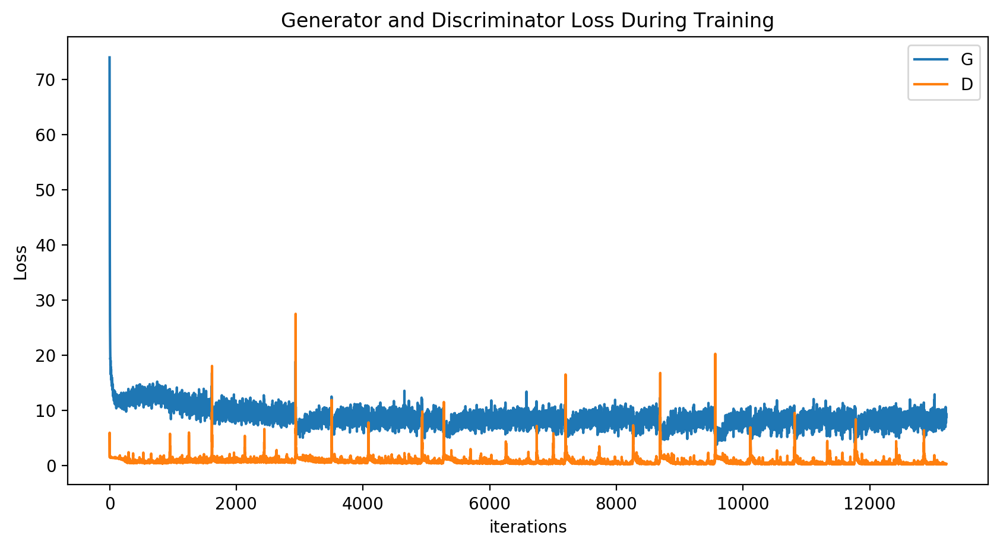

In [23]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(losses_g,label="G")
plt.plot(losses_d,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21181240 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


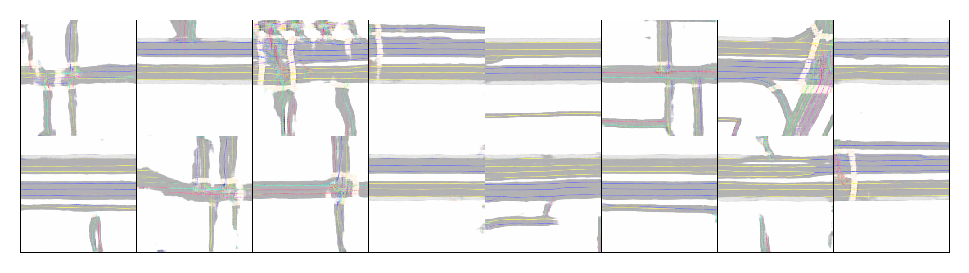

In [24]:
#%%capture
fig = plt.figure(figsize=(6,6))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in intermediate_images]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())

### Evaluate trained generator model on test data (Qualitative)

In [25]:
labeled_testset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_test,
                                  img_transform=transforms.Compose([transforms.Resize((256,256)),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

testloader = torch.utils.data.DataLoader(labeled_testset,
                                          batch_size=1,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [26]:
losses_g_L1_eval = []
inference_images = []

generator.eval()

Generator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(18, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): ResnetBlock(
      (resnet_block): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Dropout(p=0.5, inplace=False)
        (4): Conv2d(256, 256, kernel_size=(3, 3), strid

In [28]:
####################################
############ INFERENCE #############
####################################

for real_18ch, real_map in tqdm(testloader):
    real_18ch = real_18ch.to(device)
    real_map = real_map.to(device)

    """
    GENERATOR INFERENCE
    """
    gen_map = generator(real_18ch)
    loss_g_L1 = criterion_L1(gen_map, real_map)

    """
    COMPILE TRAINING STATISTICS
    """
    losses_g_L1_eval.append(loss_g_L1.item())
    inference_images.append(np.hstack((real_map.cpu().view([3,256,256]), (gen_map.detach().cpu().view([3,256,256])*0.5) + 0.5)))

100%|██████████| 504/504 [00:30<00:00, 16.79it/s]


In [ ]:
# %%capture
fig = plt.figure(figsize=(4,2))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)).squeeze(), animated=True)] for i in inference_images]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())

Animation size has reached 20974979 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
